<a href="https://colab.research.google.com/github/cathyai0320/A.I./blob/main/comp247_project_group2_part_b_v3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**COMP 247 Supervised Learning**
*   Group 2
*   Part A
*   Predict if incident would result in fatality or not

**Members (alphabetically)**
*   Boonluea, Chinnawut 301276464
*   Chan, Kai Chung     301321990
*   Mak, Chung Ping     301281670
*   Pequino, Catherine  301308416
*   Yurderi, Emre       301270260

In [ ]:
# required packages
!pip install squarify -qqq #for colab
!pip install folium -qqq #for colab

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import warnings
import datetime as dt
from sklearn.feature_selection import SelectKBest, chi2, f_classif, mutual_info_classif, RFE
from sklearn.impute import SimpleImputer, KNNImputer
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.neighbors import KNeighborsClassifier
from sklearn.preprocessing import LabelEncoder, OrdinalEncoder, OneHotEncoder, StandardScaler, FunctionTransformer
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.metrics import accuracy_score, precision_score, recall_score, confusion_matrix
from sklearn.neural_network import MLPClassifier
from sklearn.ensemble import RandomForestClassifier
from xgboost import XGBClassifier
import squarify
import holidays
import folium
from folium.plugins import MarkerCluster
import joblib
import matplotlib.ticker as ticker
from scipy.stats import chi2_contingency
from imblearn.over_sampling import SMOTE, SMOTEN, SMOTENC

warnings.filterwarnings('ignore')

**A. Data exploration**
1.   Load and describe data elements
2.   Statistical assessments
3.   Missing data evaluations
4.   Graphs and visualizations

**B. Data modelling:**
1.   Data transformations
2.   Feature selection
3.   Train, Test data splitting
4.   Managing imbalanced classes if needed
5.   Use pipelines class to streamline the transformations

In [ ]:
# Load the data into dataframe
path = '/content/KSI.csv'
df = pd.read_csv(path)

In [ ]:
# Inital exploring the records by using head
print(df.head(3))

              X             Y   INDEX_    ACCNUM  YEAR  \
0 -8.844611e+06  5.412414e+06  3387730  892658.0  2006   
1 -8.844611e+06  5.412414e+06  3387731  892658.0  2006   
2 -8.816480e+06  5.434843e+06  3388101  892810.0  2006   

                     DATE  TIME          STREET1         STREET2 OFFSET  ...  \
0  2006/03/11 05:00:00+00   852       BLOOR ST W     DUNDAS ST W    NaN  ...   
1  2006/03/11 05:00:00+00   852       BLOOR ST W     DUNDAS ST W    NaN  ...   
2  2006/03/11 05:00:00+00   915  MORNINGSIDE AVE  SHEPPARD AVE E    NaN  ...   

  AG_DRIV REDLIGHT  ALCOHOL  DISABILITY  HOOD_158 NEIGHBOURHOOD_158 HOOD_140  \
0     Yes      NaN      NaN         NaN        88   High Park North       88   
1     Yes      NaN      NaN         NaN        88   High Park North       88   
2     Yes      Yes      NaN         NaN       146      Malvern East      132   

      NEIGHBOURHOOD_140 DIVISION ObjectId  
0  High Park North (88)      D11        1  
1  High Park North (88)      D11     

In [ ]:
# Get an overview of the dataframe:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18194 entries, 0 to 18193
Data columns (total 57 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   X                  18194 non-null  float64
 1   Y                  18194 non-null  float64
 2   INDEX_             18194 non-null  int64  
 3   ACCNUM             13264 non-null  float64
 4   YEAR               18194 non-null  int64  
 5   DATE               18194 non-null  object 
 6   TIME               18194 non-null  int64  
 7   STREET1            18194 non-null  object 
 8   STREET2            16510 non-null  object 
 9   OFFSET             3402 non-null   object 
 10  ROAD_CLASS         17818 non-null  object 
 11  DISTRICT           18089 non-null  object 
 12  WARDNUM            17332 non-null  float64
 13  LATITUDE           18194 non-null  float64
 14  LONGITUDE          18194 non-null  float64
 15  LOCCOORD           18099 non-null  object 
 16  ACCLOC             127

In [ ]:
# Numeric columns
print(df.select_dtypes(exclude='object').columns)
print(df.select_dtypes(exclude='object').columns.size)

Index(['X', 'Y', 'INDEX_', 'ACCNUM', 'YEAR', 'TIME', 'WARDNUM', 'LATITUDE',
       'LONGITUDE', 'FATAL_NO', 'ObjectId'],
      dtype='object')
11


In [ ]:
# Summary statistics of the numerical columns:
print(df.describe())

                  X             Y        INDEX_        ACCNUM          YEAR  \
count  1.819400e+04  1.819400e+04  1.819400e+04  1.326400e+04  18194.000000   
mean  -8.838345e+06  5.420748e+06  3.818870e+07  4.248444e+08   2012.934869   
std    1.162533e+04  8.682160e+03  3.726463e+07  1.065503e+09      4.754258   
min   -8.865305e+06  5.402162e+06  3.363207e+06  2.530100e+04   2006.000000   
25%   -8.846591e+06  5.413242e+06  5.391370e+06  1.021229e+06   2009.000000   
50%   -8.838448e+06  5.419556e+06  7.644612e+06  1.197308e+06   2012.000000   
75%   -8.829671e+06  5.427813e+06  8.078261e+07  1.365020e+06   2017.000000   
max   -8.807929e+06  5.443099e+06  8.170606e+07  4.008024e+09   2022.000000   

               TIME       WARDNUM      LATITUDE     LONGITUDE    FATAL_NO  \
count  18194.000000  1.733200e+04  18194.000000  18194.000000  827.000000   
mean    1362.615917  2.521028e+03     43.710459    -79.396201   29.073761   
std      630.816048  1.844803e+05      0.056369      0.10

In [ ]:
# Categorical columns
print(df.select_dtypes(include='object').columns)
print(df.select_dtypes(include='object').columns.size)

Index(['DATE', 'STREET1', 'STREET2', 'OFFSET', 'ROAD_CLASS', 'DISTRICT',
       'LOCCOORD', 'ACCLOC', 'TRAFFCTL', 'VISIBILITY', 'LIGHT', 'RDSFCOND',
       'ACCLASS', 'IMPACTYPE', 'INVTYPE', 'INVAGE', 'INJURY', 'INITDIR',
       'VEHTYPE', 'MANOEUVER', 'DRIVACT', 'DRIVCOND', 'PEDTYPE', 'PEDACT',
       'PEDCOND', 'CYCLISTYPE', 'CYCACT', 'CYCCOND', 'PEDESTRIAN', 'CYCLIST',
       'AUTOMOBILE', 'MOTORCYCLE', 'TRUCK', 'TRSN_CITY_VEH', 'EMERG_VEH',
       'PASSENGER', 'SPEEDING', 'AG_DRIV', 'REDLIGHT', 'ALCOHOL', 'DISABILITY',
       'HOOD_158', 'NEIGHBOURHOOD_158', 'HOOD_140', 'NEIGHBOURHOOD_140',
       'DIVISION'],
      dtype='object')
46


In [ ]:
# Unique values in categorical columns:
for column in df.select_dtypes(include='object').columns:
    print(f"Unique values in {column}: {df[column].unique()}")

Unique values in DATE: ['2006/03/11 05:00:00+00' '2006/01/01 05:00:00+00'
 '2006/03/12 05:00:00+00' ... '2022/12/20 05:00:00+00'
 '2022/12/21 05:00:00+00' '2022/12/30 05:00:00+00']
Unique values in STREET1: ['BLOOR ST W' 'MORNINGSIDE AVE' 'WOODBINE AVE' ... 'SHAW ST'
 '936 DIXON RD' 'GLOUCESTER GRV']
Unique values in STREET2: ['DUNDAS ST W' 'SHEPPARD AVE E' 'O CONNOR DR' ... 'HOWARTH AVE'
 'CURLEW DRIVE' 'WINNETT AVE']
Unique values in OFFSET: [nan '60 NORTH OF' '6 m West of' '4 m North of' '10 m East of'
 '25 m West of' '18 m East of' '41 m South of' '50 m East of'
 '39 m East of' '10 m South of' '76 m West of' '50 m West of'
 '80 m West of' '97 m South of' '100 m East of' '48 m East of'
 '30 m South of' '1 m North of' '100 m South of' '30 m North of'
 '60 m East of' '17 m West of' '500 m East of' '234 m South of'
 '44 m North of' '7 m West of' '450 m West of' '58 m North of'
 '51 m South of' '43 m West of' '280 m East of' '5 m North of' '314 m  of'
 '500 m North of' '8 m North of' '1

In [ ]:
# Unique values in categorical columns:
for column in df.select_dtypes(include='object').columns:
    print(f"Unique values in {column}: {df[column].unique()}")

Unique values in DATE: ['2006/03/11 05:00:00+00' '2006/01/01 05:00:00+00'
 '2006/03/12 05:00:00+00' ... '2022/12/20 05:00:00+00'
 '2022/12/21 05:00:00+00' '2022/12/30 05:00:00+00']
Unique values in STREET1: ['BLOOR ST W' 'MORNINGSIDE AVE' 'WOODBINE AVE' ... 'SHAW ST'
 '936 DIXON RD' 'GLOUCESTER GRV']
Unique values in STREET2: ['DUNDAS ST W' 'SHEPPARD AVE E' 'O CONNOR DR' ... 'HOWARTH AVE'
 'CURLEW DRIVE' 'WINNETT AVE']
Unique values in OFFSET: [nan '60 NORTH OF' '6 m West of' '4 m North of' '10 m East of'
 '25 m West of' '18 m East of' '41 m South of' '50 m East of'
 '39 m East of' '10 m South of' '76 m West of' '50 m West of'
 '80 m West of' '97 m South of' '100 m East of' '48 m East of'
 '30 m South of' '1 m North of' '100 m South of' '30 m North of'
 '60 m East of' '17 m West of' '500 m East of' '234 m South of'
 '44 m North of' '7 m West of' '450 m West of' '58 m North of'
 '51 m South of' '43 m West of' '280 m East of' '5 m North of' '314 m  of'
 '500 m North of' '8 m North of' '1

In [ ]:
# Check for missing values:
miss_val = df.isnull().sum()
miss_val=miss_val.drop(miss_val[miss_val == 0].index).sort_values(ascending = False)
pd.DataFrame({'Missing Values':miss_val, 'Percent':round(miss_val/len(df),2)*100})

,Missing Values,Percent
EMERG_VEH,18151,100.0
DISABILITY,17708,97.0
CYCCOND,17429,96.0
CYCACT,17428,96.0
CYCLISTYPE,17420,96.0
ALCOHOL,17406,96.0
FATAL_NO,17367,95.0
TRSN_CITY_VEH,17084,94.0
TRUCK,17072,94.0
REDLIGHT,16674,92.0


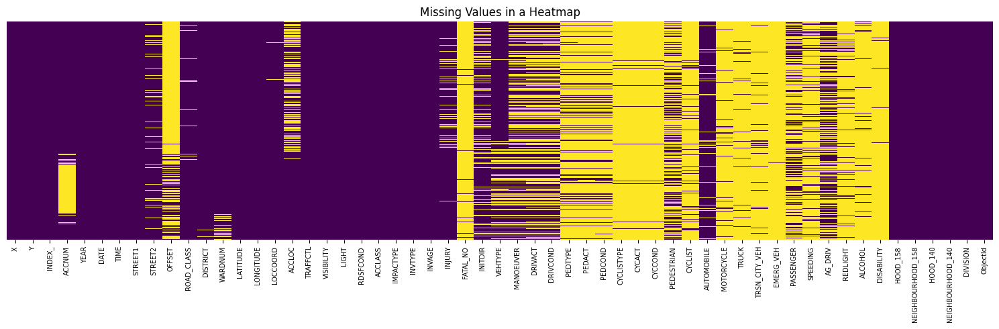

In [ ]:
# Heatmap showing missing values
fig = plt.figure(figsize=(15,5))
sns.heatmap(df.isnull(), yticklabels="", cmap="viridis", cbar=False)
plt.title('Missing Values in a Heatmap')
plt.xticks(size=7)
plt.tight_layout()
plt.show()

In [ ]:
# Print the unique value the target ACCLASS
print(df['ACCLASS'].unique())

['Fatal' 'Non-Fatal Injury' 'Property Damage Only' nan]


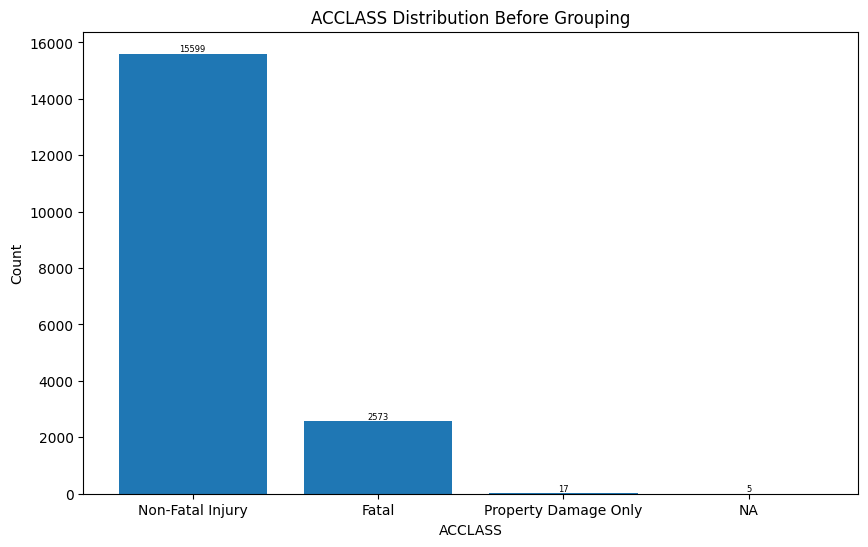

In [ ]:
# Plot the ACCLASS frequency
df['ACCLASS'].fillna('NA', inplace=True) # Later need to drop those rows
plt.figure(figsize=(10, 6))
plt.bar(df['ACCLASS'].value_counts().index, df['ACCLASS'].value_counts().values)
plt.xlabel('ACCLASS')
plt.ylabel('Count')
plt.title('ACCLASS Distribution Before Grouping')
for index, value in enumerate(df['ACCLASS'].value_counts().values):
    plt.text(index, value, str(value), ha='center', fontsize=6, va='bottom')
plt.show()

In [ ]:
# Drop the rows with 'NA' in the 'ACCLASS' column
print(df.shape[0])
df = df[df['ACCLASS'] != 'NA']
print(df.shape[0])

18194
18189


In [ ]:
# Convert the ACCLASS into binary as a new column TARGET
df['TARGET'] = df['ACCLASS'].map(lambda x: 1 if x == 'Fatal' else 0)

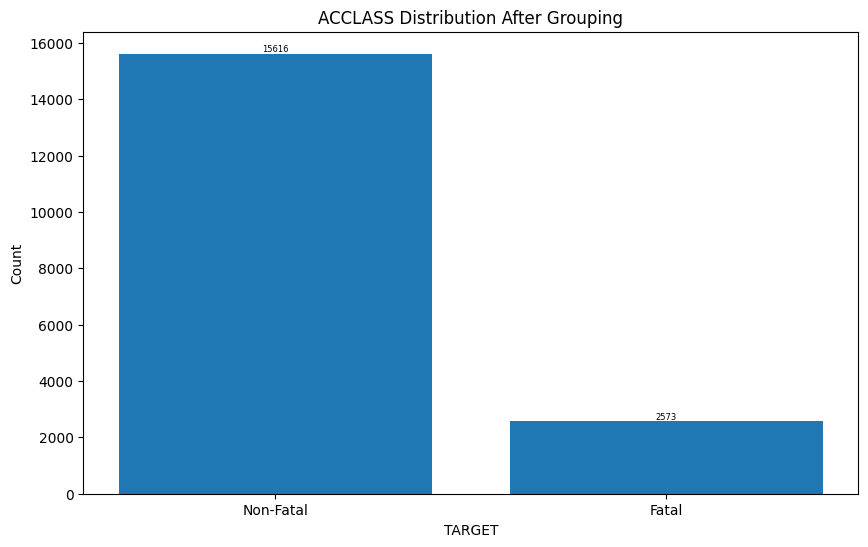

In [ ]:
# Plot the ACCLASS frequency
plt.figure(figsize=(10, 6))
plt.bar(['Non-Fatal', 'Fatal'], df['TARGET'].value_counts().values)
plt.xlabel('TARGET')
plt.ylabel('Count')
plt.title('ACCLASS Distribution After Grouping')
for index, value in enumerate(df['TARGET'].value_counts().values):
    plt.text(index, value, str(value), ha='center', fontsize=6, va='bottom')
plt.show()

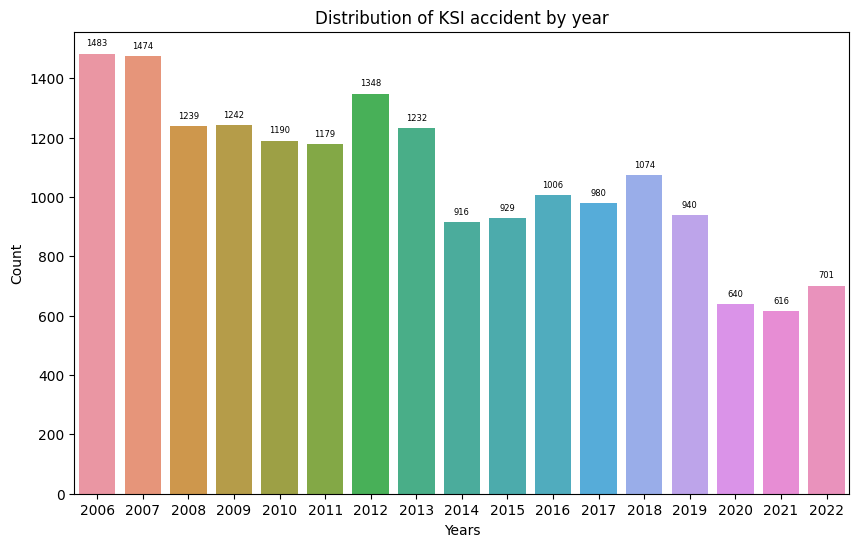

In [ ]:
# Distribution of total accident by year
plt.figure(figsize=(10, 6))
axis = sns.countplot(x=df['YEAR'])
plt.title("Distribution of KSI accident by year")
plt.xlabel("Years")
plt.ylabel("Count")
for p in axis.patches:
    count = int(p.get_height())
    axis.text(p.get_x() + p.get_width() / 2., count + 20, str(count), ha='center', va='bottom', fontsize=6, color='black')
plt.show()

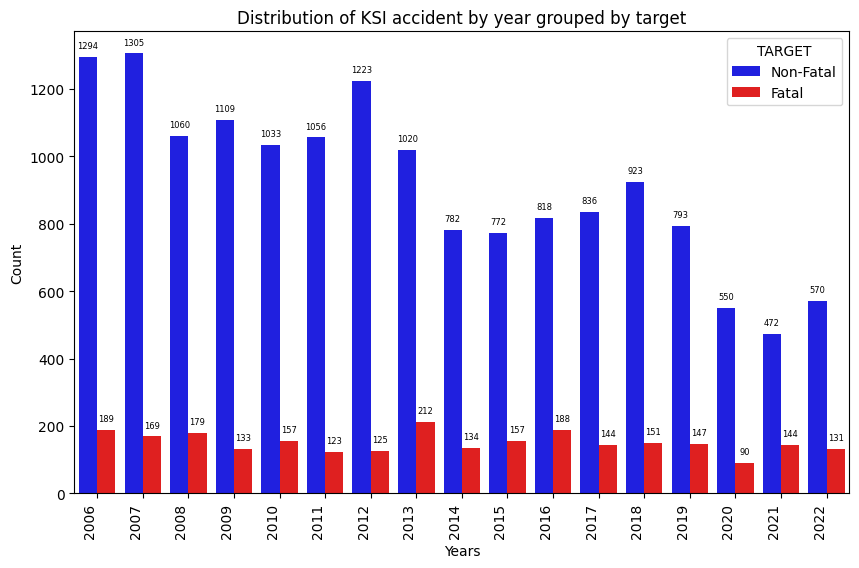

In [ ]:
# Distribution of KSI accident by year grouped by target
plt.figure(figsize=(10, 6))
axis = sns.countplot(x='YEAR', hue='TARGET', data=df, palette={0: 'blue', 1: 'red'})
plt.title("Distribution of KSI accident by year grouped by target")
plt.xlabel("Years")
plt.ylabel("Count")
plt.xticks(rotation=90, ha='right')
plt.legend(title='TARGET', labels=['Non-Fatal', 'Fatal'])
for p in axis.patches:
    count = int(p.get_height())
    axis.text(p.get_x() + p.get_width() / 2., count + 20, count, ha='center', va='bottom', fontsize=6, color='black')
plt.show()

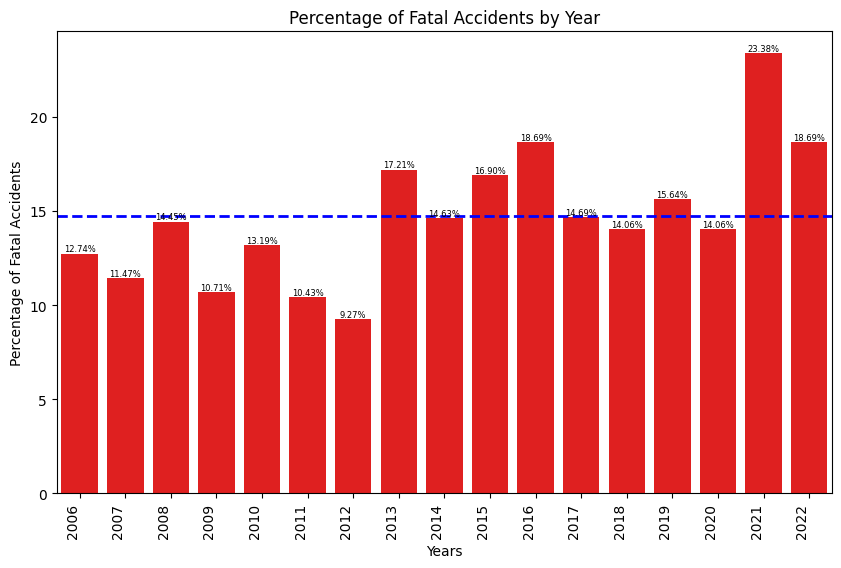

In [ ]:
# Group the data by 'YEAR' and 'TARGET' and calculate the counts
grouped_data = df.groupby(['YEAR', 'TARGET']).size().unstack().fillna(0)
grouped_data['Percentage Fatal'] = grouped_data[1] / (grouped_data[0] + grouped_data[1]) * 100
plt.figure(figsize=(10, 6))
mean_percentage_fatal = grouped_data['Percentage Fatal'].mean()
plt.axhline(mean_percentage_fatal, color='blue', linestyle='dashed', linewidth=2, label='Mean Percentage')
sns.barplot(x=grouped_data.index, y='Percentage Fatal', data=grouped_data, color='red')
plt.title("Percentage of Fatal Accidents by Year")
plt.xlabel("Years")
plt.ylabel("Percentage of Fatal Accidents")
plt.xticks(rotation=90, ha='right')
for index, value in enumerate(grouped_data['Percentage Fatal']):
    plt.text(index, value, f'{value:.2f}%', ha='center', va='bottom', fontsize=6, color='black')
plt.show()

In [ ]:
# DATE create one feature by grouping as month
df['DATE'] = pd.to_datetime(df['DATE'])
df['MONTH'] = df['DATE'].dt.month

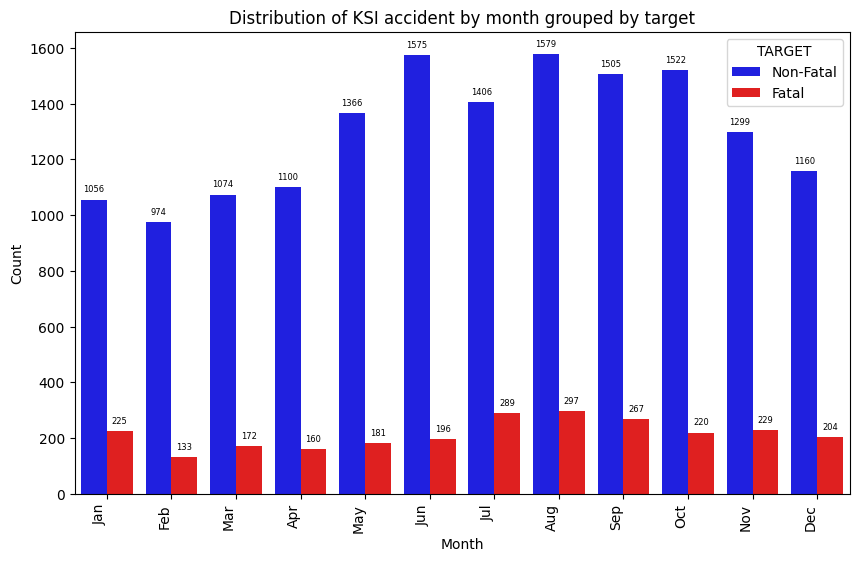

In [ ]:
# Distribution of KSI accident by month grouped by target
plt.figure(figsize=(10, 6))
axis = sns.countplot(x='MONTH', hue='TARGET', data=df, palette={0: 'blue', 1: 'red'})
plt.title("Distribution of KSI accident by month grouped by target")
plt.xlabel('Month')
plt.ylabel('Count')
plt.xticks(rotation=90, ha='right', ticks=range(12), labels=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
plt.legend(title='TARGET', labels=['Non-Fatal', 'Fatal'])
for p in axis.patches:
    count = int(p.get_height())
    axis.text(p.get_x() + p.get_width() / 2., count + 20, count, ha='center', va='bottom', fontsize=6, color='black')
plt.show()

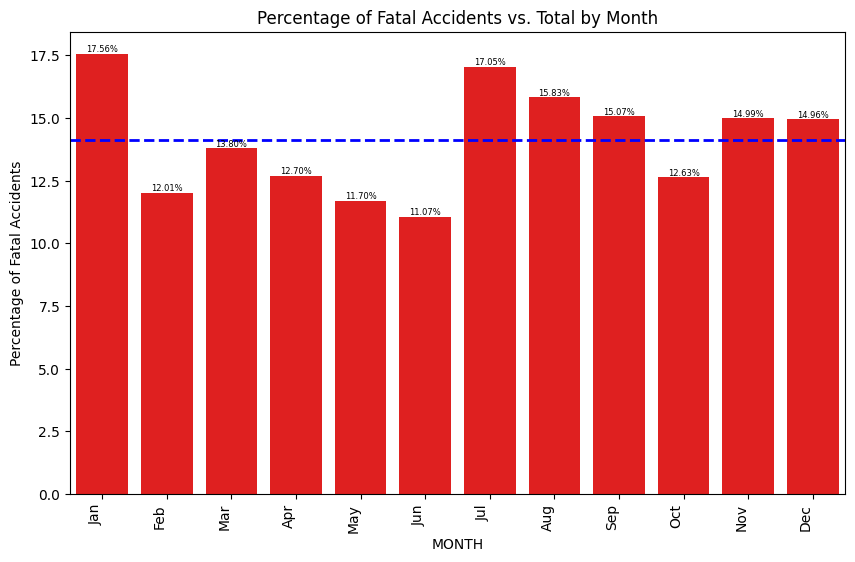

In [ ]:
# Group the data by 'MONTH' and 'TARGET' and calculate the counts
grouped_data = df.groupby(['MONTH', 'TARGET']).size().unstack().fillna(0)
grouped_data['Percentage Fatal'] = grouped_data[1] / (grouped_data[0] + grouped_data[1]) * 100
plt.figure(figsize=(10, 6))
sns.barplot(x=grouped_data.index, y='Percentage Fatal', data=grouped_data, color='red')
mean_percentage_fatal = grouped_data['Percentage Fatal'].mean()
plt.axhline(mean_percentage_fatal, color='blue', linestyle='dashed', linewidth=2, label='Mean Percentage')
plt.title("Percentage of Fatal Accidents vs. Total by Month")
plt.xlabel("MONTH")
plt.ylabel("Percentage of Fatal Accidents")
plt.xticks(rotation=90, ha='right', ticks=range(12), labels=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
for index, value in enumerate(grouped_data['Percentage Fatal']):
    plt.text(index, value, f'{value:.2f}%', ha='center', va='bottom', fontsize=6, color='black')
plt.show()

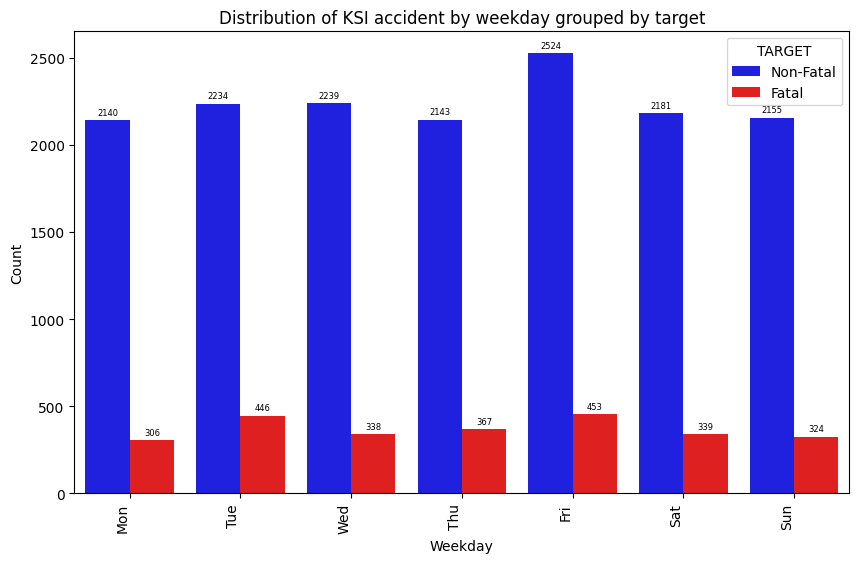

In [ ]:
# DATE create another feature WEEKDAY
df['WEEKDAY'] = df['DATE'].dt.weekday
# Monday: 0
# Tuesday: 1
# Wednesday: 2
# Thursday: 3
# Friday: 4
# Saturday: 5
# Sunday: 6
plt.figure(figsize=(10, 6))
axis = sns.countplot(x='WEEKDAY', hue='TARGET', data=df, palette={0: 'blue', 1: 'red'})
plt.title("Distribution of KSI accident by weekday grouped by target")
plt.xlabel('Weekday')
plt.ylabel('Count')
plt.xticks(rotation=90, ha='right', ticks=range(7), labels=['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun'])
plt.legend(title='TARGET', labels=['Non-Fatal', 'Fatal'])
for p in axis.patches:
    count = int(p.get_height())
    axis.text(p.get_x() + p.get_width() / 2., count + 20, count, ha='center', va='bottom', fontsize=6, color='black')
plt.show()

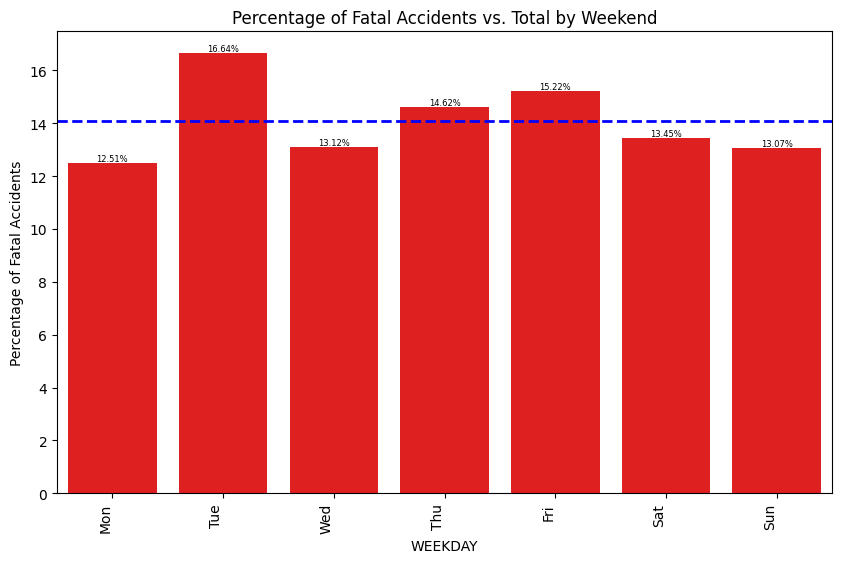

In [ ]:
# Group the data by 'WEEKDAY' and 'TARGET' and calculate the counts
grouped_data = df.groupby(['WEEKDAY', 'TARGET']).size().unstack().fillna(0)
grouped_data['Percentage Fatal'] = grouped_data[1] / (grouped_data[0] + grouped_data[1]) * 100
plt.figure(figsize=(10, 6))
sns.barplot(x=grouped_data.index, y='Percentage Fatal', data=grouped_data, color='red')
mean_percentage_fatal = grouped_data['Percentage Fatal'].mean()
plt.axhline(mean_percentage_fatal, color='blue', linestyle='dashed', linewidth=2, label='Mean Percentage')
plt.title("Percentage of Fatal Accidents vs. Total by Weekend")
plt.xlabel("WEEKDAY")
plt.ylabel("Percentage of Fatal Accidents")
plt.xticks(rotation=90, ha='right', ticks=range(7), labels=['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun'])
for index, value in enumerate(grouped_data['Percentage Fatal']):
    plt.text(index, value, f'{value:.2f}%', ha='center', va='bottom', fontsize=6, color='black')
plt.show()

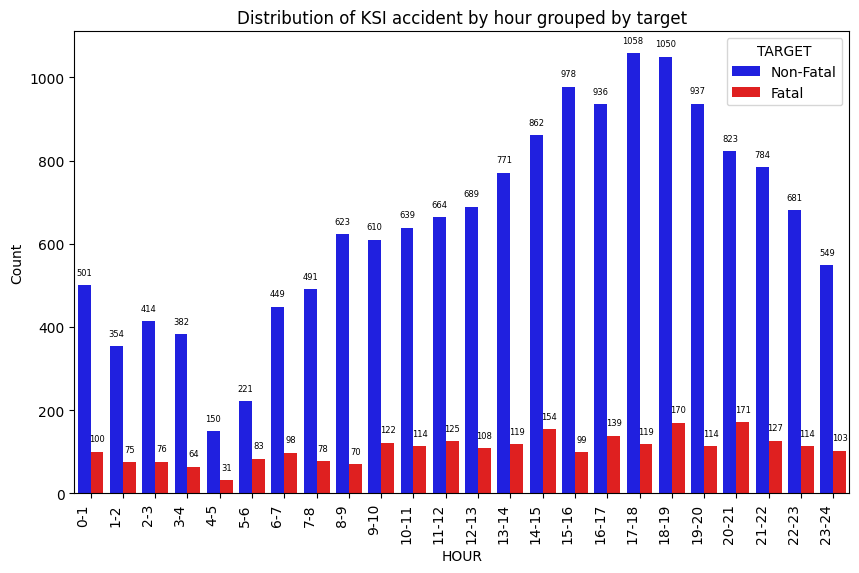

In [ ]:
# TIME creates feature HOUR
df['HOUR'] = [(i // 100) % 24 for i in df['TIME']] # 0 - 23
plt.figure(figsize=(10, 6))
axis = sns.countplot(x='HOUR', hue='TARGET', data=df, palette={0: 'blue', 1: 'red'})
plt.title("Distribution of KSI accident by hour grouped by target")
plt.xlabel('HOUR')
plt.ylabel('Count')
plt.xticks(rotation=90, ha='right', ticks=range(24), labels=[f'{hour}-{hour+1}' for hour in range(24)])
plt.legend(title='TARGET', labels=['Non-Fatal', 'Fatal'])
for p in axis.patches:
    count = int(p.get_height())
    axis.text(p.get_x() + p.get_width() / 2., count + 20, count, ha='center', va='bottom', fontsize=6, color='black')
plt.show()

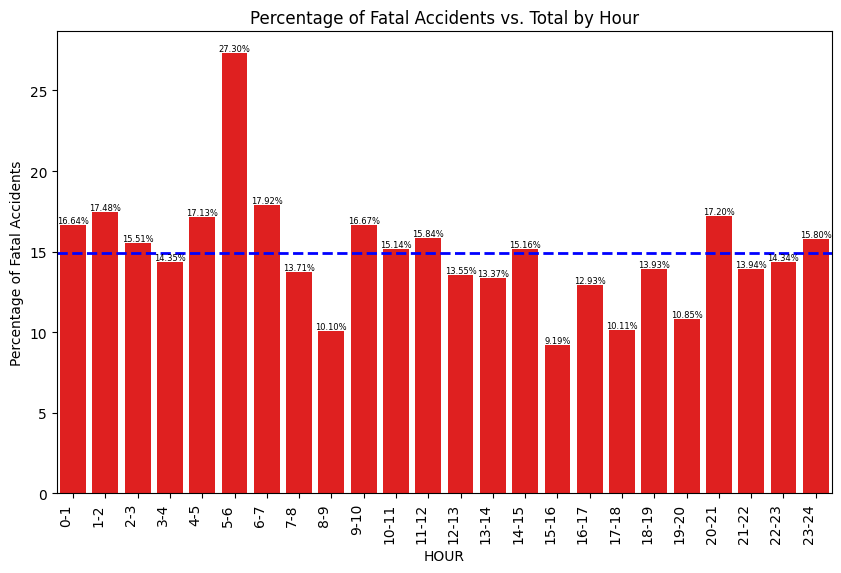

In [ ]:
# Group the data by 'HOUR' and 'TARGET' and calculate the counts
grouped_data = df.groupby(['HOUR', 'TARGET']).size().unstack().fillna(0)
grouped_data['Percentage Fatal'] = grouped_data[1] / (grouped_data[0] + grouped_data[1]) * 100
plt.figure(figsize=(10, 6))
sns.barplot(x=grouped_data.index, y='Percentage Fatal', data=grouped_data, color='red')
mean_percentage_fatal = grouped_data['Percentage Fatal'].mean()
plt.axhline(mean_percentage_fatal, color='blue', linestyle='dashed', linewidth=2, label='Mean Percentage')
plt.title("Percentage of Fatal Accidents vs. Total by Hour")
plt.xlabel("HOUR")
plt.ylabel("Percentage of Fatal Accidents")
plt.xticks(rotation=90, ha='right', ticks=range(24), labels=[f'{hour}-{hour+1}' for hour in range(24)])
for index, value in enumerate(grouped_data['Percentage Fatal']):
    plt.text(index, value, f'{value:.2f}%', ha='center', va='bottom', fontsize=6, color='black')
plt.show()

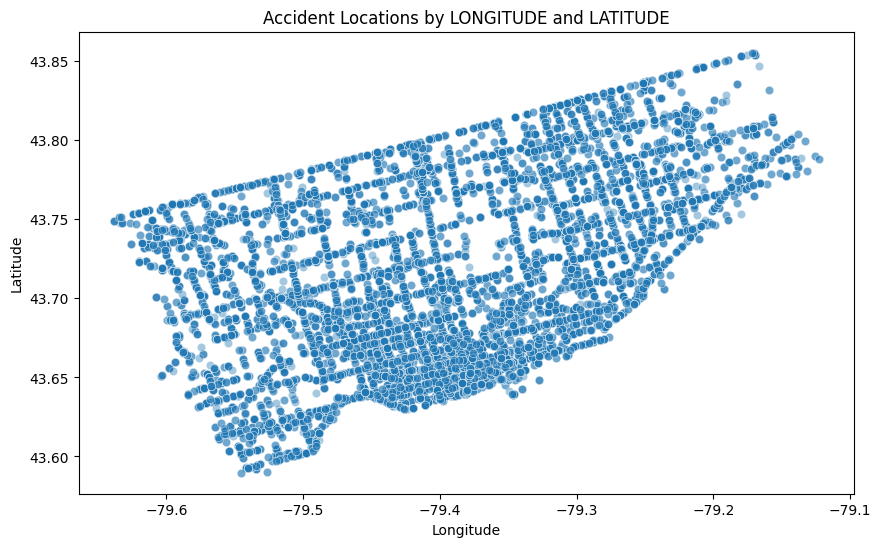

In [ ]:
# Create a scatter plot using x and y coordinates
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df, x='LONGITUDE', y='LATITUDE', alpha=0.4)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Accident Locations by LONGITUDE and LATITUDE')
plt.show()

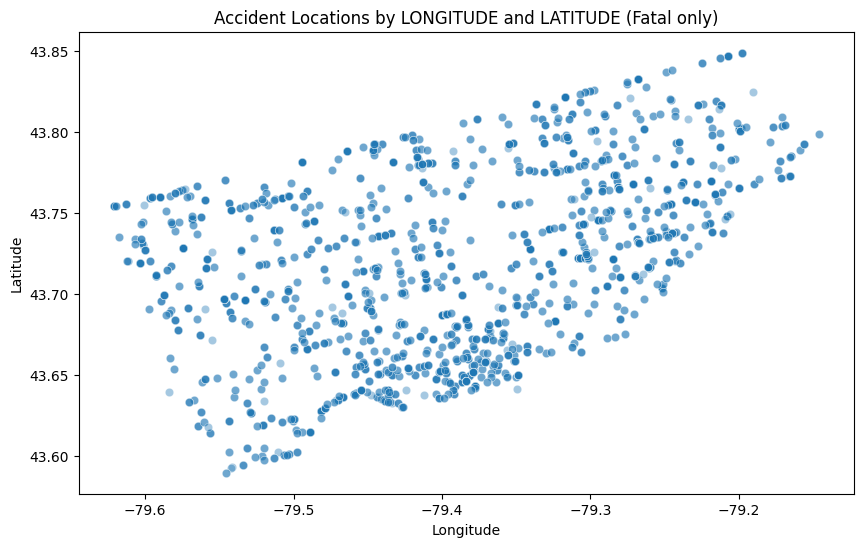

In [ ]:
# Create a scatter plot using LONGITUDE and LATITUDE coordinates for fatal only
plt.figure(figsize=(10, 6))
sns.scatterplot(data=df[df['TARGET'] == 1], x='LONGITUDE', y='LATITUDE', alpha=0.4)
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Accident Locations by LONGITUDE and LATITUDE (Fatal only)')
plt.show()

In [ ]:
# Map representation
center_latitude = df['LATITUDE'].median()
center_longitude = df['LONGITUDE'].median()
zoom_level = 11
m = folium.Map(location=[center_latitude, center_longitude], zoom_start=zoom_level)
locations = [(lat, lon) for lat, lon in zip(df['LATITUDE'], df['LONGITUDE'])]
marker_cluster = MarkerCluster().add_to(m)
for lat, lon in locations:
    folium.Marker(
        location=[lat, lon],
        popup=f"Latitude: {lat}, Longitude: {lon}"
    ).add_to(marker_cluster)

display(m)

In [ ]:
# Map representation for Fatal only
df_fatal = df[df['ACCLASS']=='Fatal']
# Map representation only the Fatal accidents
center_latitude = df_fatal['LATITUDE'].median()
center_longitude = df_fatal['LONGITUDE'].median()
zoom_level = 11
m = folium.Map(location=[center_latitude, center_longitude], zoom_start=zoom_level)
locations = [(lat, lon) for lat, lon in zip(df_fatal['LATITUDE'], df_fatal['LONGITUDE'])]
marker_cluster = MarkerCluster().add_to(m)
for lat, lon in locations:
    folium.Marker(
        location=[lat, lon],
        popup=f"Latitude: {lat}, Longitude: {lon}"
    ).add_to(marker_cluster)

display(m)

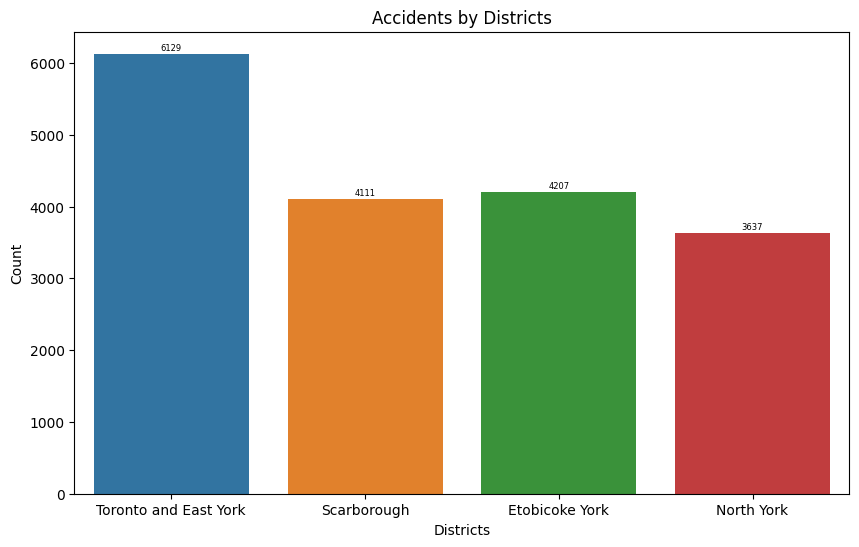

In [ ]:
# Accidents by Districts
df.loc[df["DISTRICT"]=="Toronto East York", "DISTRICT"] = 'Toronto and East York'
plt.figure(figsize=(10, 6))
axis = sns.countplot(x=df['DISTRICT'])
plt.title("Accidents by Districts")
plt.xlabel("Districts")
plt.ylabel("Count")
for p in axis.patches:
    count = int(p.get_height())
    axis.text(p.get_x() + p.get_width() / 2., count + 20, count, ha='center', va='bottom', fontsize=6, color='black')
plt.show()

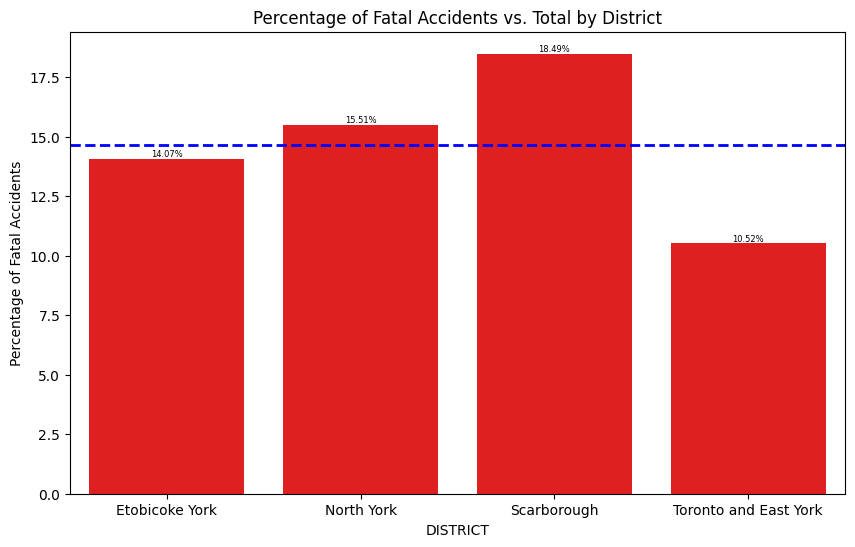

In [ ]:
# Group the data by 'DISTRICT' and 'TARGET' and calculate the counts
grouped_data = df.groupby(['DISTRICT', 'TARGET']).size().unstack().fillna(0)
grouped_data['Percentage Fatal'] = grouped_data[1] / (grouped_data[0] + grouped_data[1]) * 100
plt.figure(figsize=(10, 6))
sns.barplot(x=grouped_data.index, y='Percentage Fatal', data=grouped_data, color='red')
mean_percentage_fatal = grouped_data['Percentage Fatal'].mean()
plt.axhline(mean_percentage_fatal, color='blue', linestyle='dashed', linewidth=2, label='Mean Percentage')
plt.title("Percentage of Fatal Accidents vs. Total by District")
plt.xlabel("DISTRICT")
plt.ylabel("Percentage of Fatal Accidents")
for index, value in enumerate(grouped_data['Percentage Fatal']):
    plt.text(index, value, f'{value:.2f}%', ha='center', va='bottom', fontsize=6, color='black')
plt.show()

In [ ]:
# Drop the unrelated columns, reason will be explained at the end of file
droppedCol = ["X", "Y", "STREET1", "STREET2", "OFFSET", "INDEX_", "ACCNUM", "WARDNUM", "LOCCOORD", "FATAL_NO", "INITDIR", "VEHTYPE", "MANOEUVER", "DRIVCOND", "PEDTYPE", "PEDCOND", "CYCLISTYPE", "CYCCOND", "HOOD_140", "NEIGHBOURHOOD_140", "NEIGHBOURHOOD_158", "DIVISION", "ObjectId", "INJURY"]
droppedData = df.drop(columns=droppedCol)

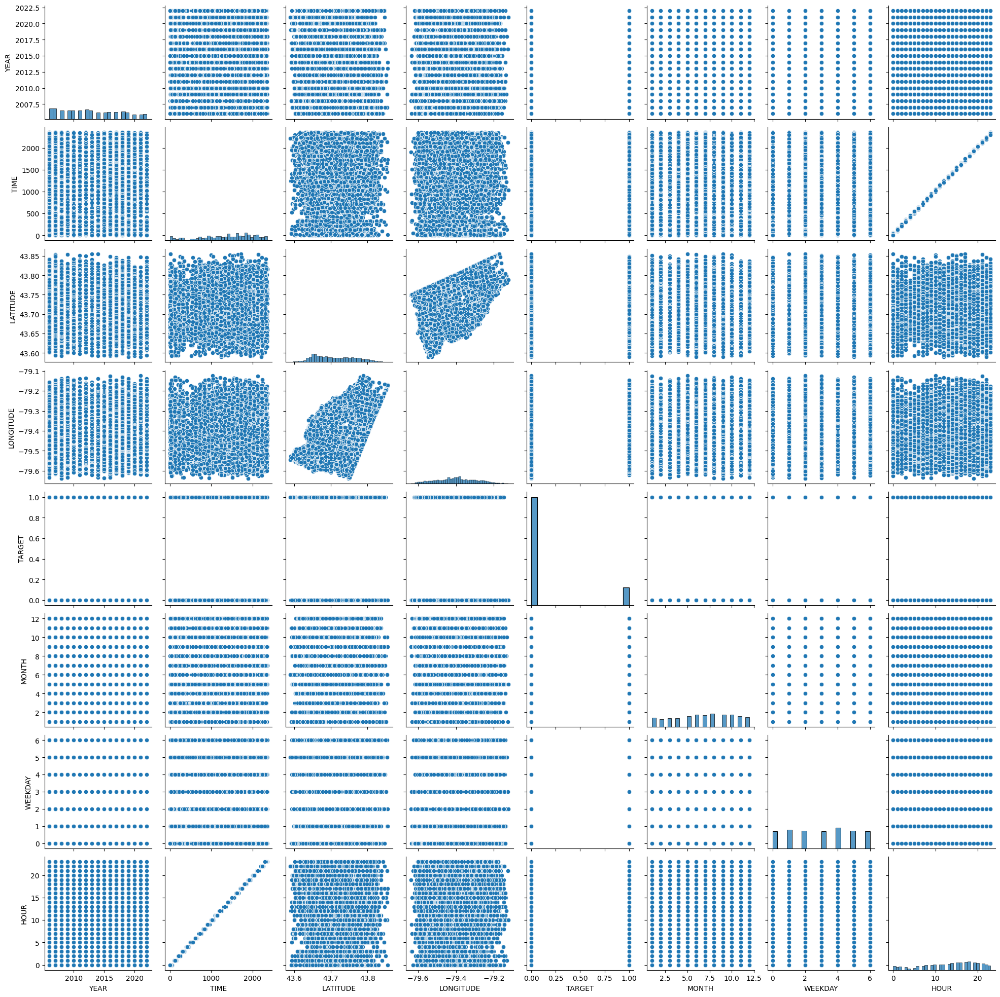

In [ ]:
# Create the pairplot
sns.pairplot(droppedData)
plt.show()

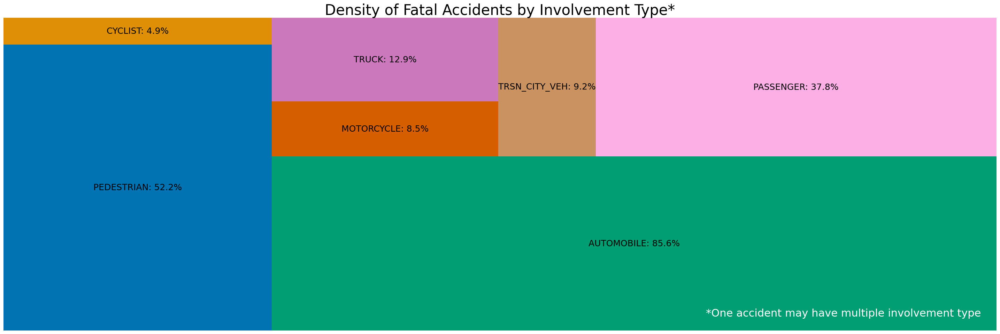

In [ ]:
#TREEMAP FOR ACCIDENT INVOLVEMENT TYPE IS ADDED
df["TARGET"] = df['ACCLASS'].apply(lambda x: 1 if x == "Fatal" else 0)
def binary_feature_find_total(feature):
  return (df[df['TARGET']==1][feature].isnull()==False).sum()

def binary_feature_label(feature):
  percentage=(df[df['TARGET']==1][feature].isnull()==False).sum() / (df[df['TARGET']==1]['TARGET'].count())*100
  nl = '\n'
  text = f"{feature}: {round(percentage,1)}%"
  return text

values=[binary_feature_find_total('PEDESTRIAN'),
        binary_feature_find_total('CYCLIST'),
        binary_feature_find_total('AUTOMOBILE'),
        binary_feature_find_total('MOTORCYCLE'),
        binary_feature_find_total('TRUCK'),
        binary_feature_find_total('TRSN_CITY_VEH'),
        #binary_feature_find_total('EMERG_VEH'),
        binary_feature_find_total('PASSENGER')]
values

labels=[binary_feature_label('PEDESTRIAN'),
        binary_feature_label('CYCLIST'),
        binary_feature_label('AUTOMOBILE'),
        binary_feature_label('MOTORCYCLE'),
        binary_feature_label('TRUCK'),
        binary_feature_label('TRSN_CITY_VEH'),
        #binary_feature_find_total('EMERG_VEH'),
        binary_feature_label('PASSENGER')]

fig=plt.figure(figsize=(30,10))
squarify.plot(values, label=labels, pad=0, color=sns.color_palette("colorblind",
                                     len(values)),
              text_kwargs={'fontsize': 18})

note_text = "*One accident may have multiple involvement type"
plt.text(0.94, 0.08, note_text, ha='right', va='bottom', fontsize=22, transform=fig.transFigure, color='w')

plt.title('Density of Fatal Accidents by Involvement Type*', size=30)
plt.axis("off")
plt.tight_layout()
plt.show()

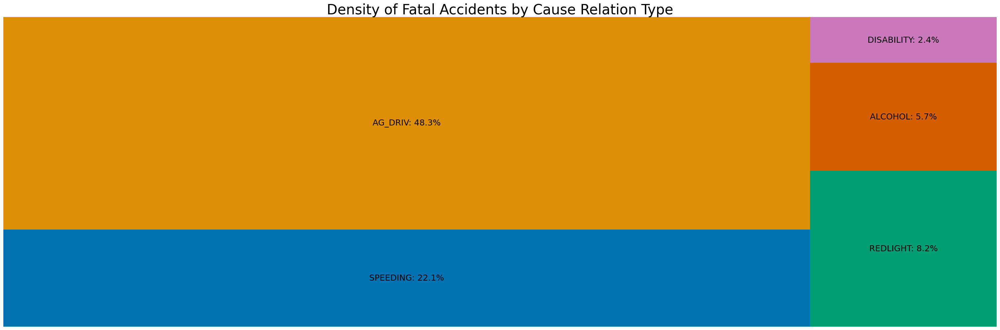

In [ ]:
#TREEMAP FOR ACCIDENT CAUSE RELATION TYPE IS ADDED
values=[binary_feature_find_total('SPEEDING'),
        binary_feature_find_total('AG_DRIV'),
        binary_feature_find_total('REDLIGHT'),
        binary_feature_find_total('ALCOHOL'),
        binary_feature_find_total('DISABILITY')]

labels=[binary_feature_label('SPEEDING'),
        binary_feature_label('AG_DRIV'),
        binary_feature_label('REDLIGHT'),
        binary_feature_label('ALCOHOL'),
        binary_feature_label('DISABILITY')]

fig=plt.figure(figsize=(30,10))
squarify.plot(values, label=labels, pad=0, color=sns.color_palette("colorblind",
                                     len(values)),
              text_kwargs={'fontsize': 18})

plt.title('Density of Fatal Accidents by Cause Relation Type', size=30)
plt.axis("off")
plt.tight_layout()
plt.show()

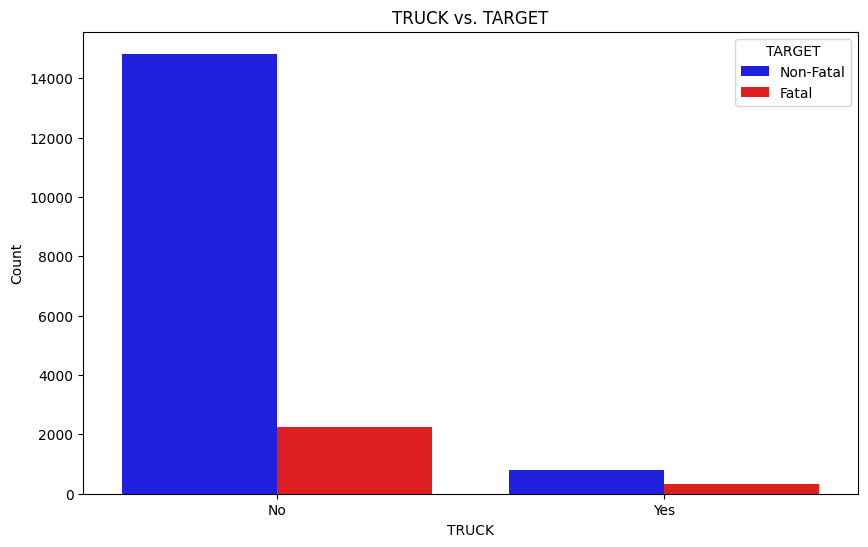

In [ ]:
# Plot for 'TRUCK'
df["TRUCK"].fillna("No", inplace=True)
plt.figure(figsize=(10, 6))
axix = sns.countplot(x='TRUCK', hue='TARGET', data=df, palette={0: 'blue', 1: 'red'})
plt.title('TRUCK vs. TARGET')
plt.xlabel('TRUCK')
plt.ylabel('Count')
plt.legend(title='TARGET', labels=['Non-Fatal', 'Fatal'])
plt.show()

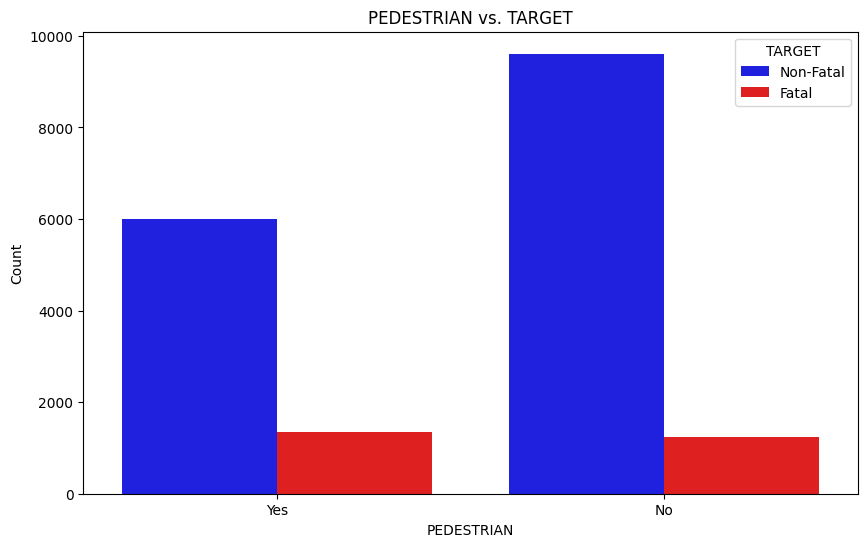

In [ ]:
# Plot for 'PEDESTRIAN'
df["PEDESTRIAN"].fillna("No", inplace=True)
plt.figure(figsize=(10, 6))
sns.countplot(x='PEDESTRIAN', hue='TARGET', data=df, palette={0: 'blue', 1: 'red'})
plt.title('PEDESTRIAN vs. TARGET')
plt.xlabel('PEDESTRIAN')
plt.ylabel('Count')
plt.legend(title='TARGET', labels=['Non-Fatal', 'Fatal'])
plt.show()

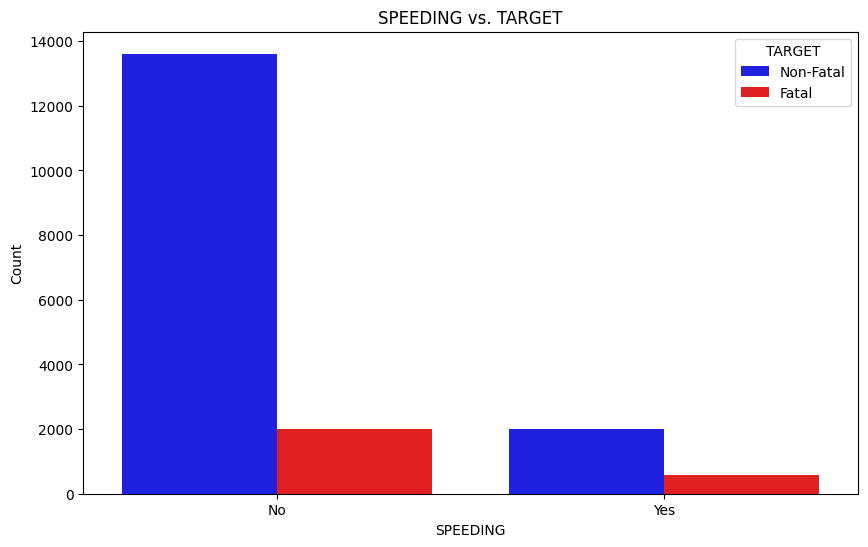

In [ ]:
# Plot for 'SPEEDING'
df["SPEEDING"].fillna("No", inplace=True)
plt.figure(figsize=(10, 6))
sns.countplot(x='SPEEDING', hue='TARGET', data=df, palette={0: 'blue', 1: 'red'})
plt.title('SPEEDING vs. TARGET')
plt.xlabel('SPEEDING')
plt.ylabel('Count')
plt.legend(title='TARGET', labels=['Non-Fatal', 'Fatal'])
plt.show()

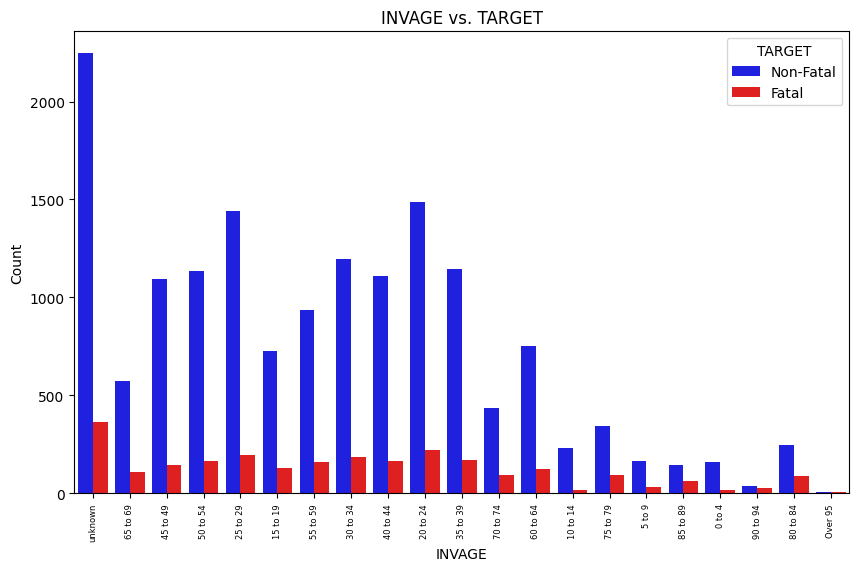

In [ ]:
# Plot for 'INVAGE'
plt.figure(figsize=(10, 6))
sns.countplot(x='INVAGE', hue='TARGET', data=df, palette={0: 'blue', 1: 'red'})
plt.title('INVAGE vs. TARGET')
plt.xlabel('INVAGE')
plt.ylabel('Count')
plt.legend(title='TARGET', labels=['Non-Fatal', 'Fatal'])
plt.xticks(rotation=90, fontsize=6)
plt.show()

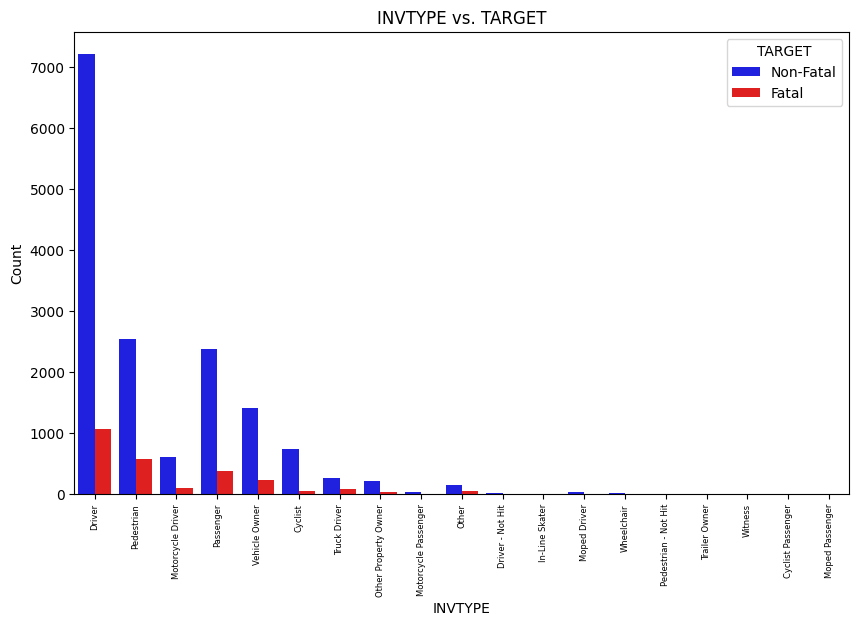

In [ ]:
# Plot for 'INVTYPE'
plt.figure(figsize=(10, 6))
sns.countplot(x='INVTYPE', hue='TARGET', data=df, palette={0: 'blue', 1: 'red'})
plt.title('INVTYPE vs. TARGET')
plt.xlabel('INVTYPE')
plt.ylabel('Count')
plt.legend(title='TARGET', labels=['Non-Fatal', 'Fatal'])
plt.xticks(rotation=90, fontsize=6)
plt.show()

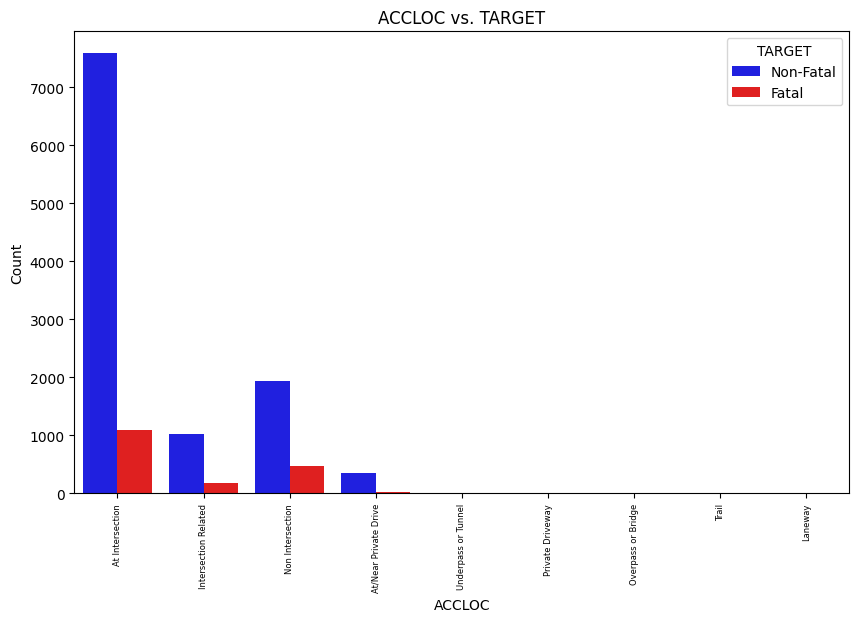

In [ ]:
# Plot for 'ACCLOC'
plt.figure(figsize=(10, 6))
sns.countplot(x='ACCLOC', hue='TARGET', data=df, palette={0: 'blue', 1: 'red'})
plt.title('ACCLOC vs. TARGET')
plt.xlabel('ACCLOC')
plt.ylabel('Count')
plt.legend(title='TARGET', labels=['Non-Fatal', 'Fatal'])
plt.xticks(rotation=90, fontsize=6)
plt.show()

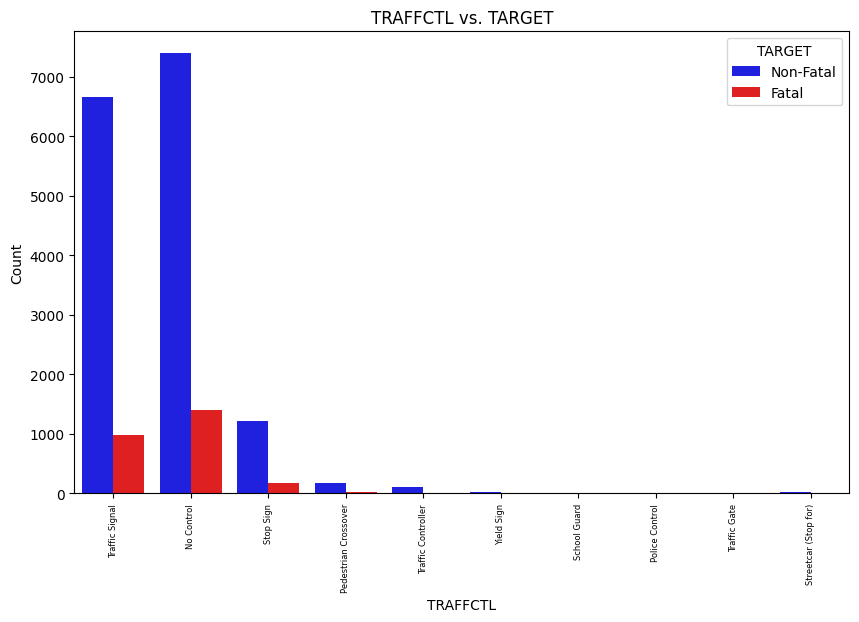

In [ ]:
# Plot for 'TRAFFCTL'
plt.figure(figsize=(10, 6))
sns.countplot(x='TRAFFCTL', hue='TARGET', data=df, palette={0: 'blue', 1: 'red'})
plt.title('TRAFFCTL vs. TARGET')
plt.xlabel('TRAFFCTL')
plt.ylabel('Count')
plt.legend(title='TARGET', labels=['Non-Fatal', 'Fatal'])
plt.xticks(rotation=90, fontsize=6)
plt.show()

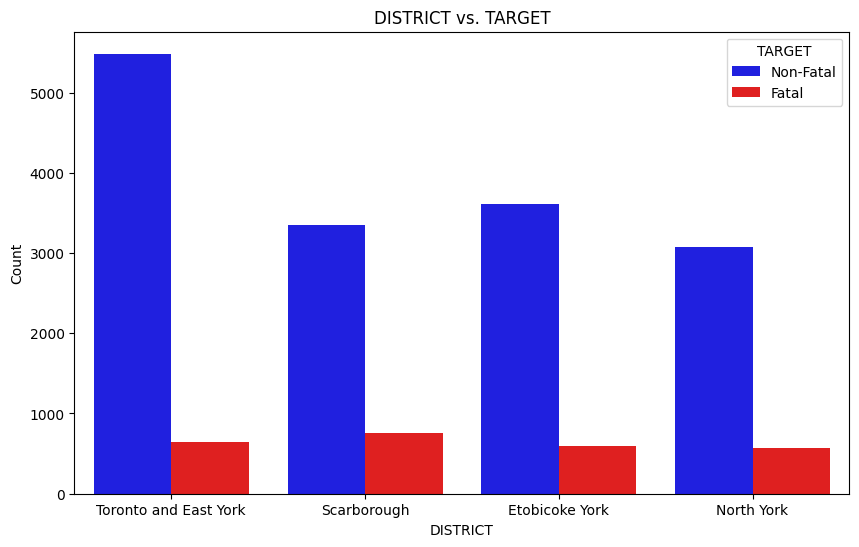

In [ ]:
# Plot for 'DISTRICT'
plt.figure(figsize=(10, 6))
sns.countplot(x='DISTRICT', hue='TARGET', data=df, palette={0: 'blue', 1: 'red'})
plt.title('DISTRICT vs. TARGET')
plt.xlabel('DISTRICT')
plt.ylabel('Count')
plt.legend(title='TARGET', labels=['Non-Fatal', 'Fatal'])
plt.show()

After finishing the data exploration, now perform the data preprocessing and transformation.

In [ ]:
# drop the rows without target value
def drop_rows_without_target_value(data, target_column):
    data.dropna(subset=[target_column], inplace=True)
    return data

In [ ]:
# Function to convert multiple columns to binary
def transform_to_binary(data, columns):
    for column in columns:
        data[column] = data[column].fillna("No")
        data[column] = data[column].replace({'Yes': 1, 'No': 0})
    return data

In [ ]:
# Function to convert multiple columns to binary
def drop_unnecessary_column(data, columns):
    for column in columns:
        data = data.drop([column], axis=1)
    return data

In [ ]:
# function to map binary
def transform_target_to_binary(data, target_column):
    data[target_column] = data[target_column].map(lambda x: 1 if x == 'Fatal' else 0)
    return data

In [ ]:
# function to convert DRIVACT to DRIVER_PROBLEM
def creating_new_driver_problem_by_driver_action(data):
   data['DRIVER_PROBLEM'] = np.where(data['DRIVACT'].isin(['Failed to Yield Right of Way','Disobeyed Traffic Control','Improper Passing','Improper Turn','Exceeding Speed Limit',
'Following too Close','Lost control','Improper Lane Change','Speed too Fast For Condition','Wrong Way on One Way Road','Speed too Slow']), 1, 0)
   data = data.drop(["DRIVACT"], axis=1)
   return data

In [ ]:
# function to convert PEDACT to PEDESTRAIN_PROBLEM
def creating_new_pedestrain_problem_by_pedestrain_action(data):
     data['PEDESTRAIN_PROBLEM'] = np.where(data['PEDACT'].isin(['Running onto Roadway','Crossing without right of way','Crossing marked crosswalk without ROW','Walking on Roadway Against Traffic','Walking on Roadway with Traffic','Playing or Working on Highway']), 1, 0)
     data = data.drop(["PEDACT"], axis=1)
     return data

In [ ]:
# function to convert CYCACT to CYCLIST_PROBLEM
def creating_new_cyclist_problem_by_cyclist_action(data):
    data['CYCLIST_PROBLEM'] = np.where(data['CYCACT'].isin(['Failed to Yield Right of Way','Improper Passing','Disobeyed Traffic Control','Lost control','Improper Turn', 'Improper Lane Change', 'Following too Close','Speed too Fast For Condition', 'Wrong Way on One Way Road']), 1, 0)
    data = data.drop(["CYCACT"], axis=1)
    return data

In [ ]:
# function to convert DATE to MONTH and WEEKDAY variable
def creating_new_month_and_weekday_and_hour_by_date_and_time(data):
    data['DATE'] = pd.to_datetime(data['DATE'])
    data['MONTH'] = data['DATE'].dt.month
    data['WEEKDAY'] = data['DATE'].dt.weekday
    data['HOUR'] = data['HOUR'] = [(i // 100) % 24 for i in df['TIME']]
    data = data.drop(["DATE", "TIME"], axis=1)
    return data

In [ ]:
def transform_age(data, column):
    age_mapping = {
      '0 to 4': 2,
      '5 to 9': 7,
      '10 to 14': 12,
      '15 to 19': 17,
      '20 to 24': 22,
      '25 to 29': 27,
      '30 to 34': 32,
      '35 to 39': 37,
      '40 to 44': 42,
      '45 to 49': 47,
      '50 to 54': 52,
      '55 to 59': 57,
      '60 to 64': 62,
      '65 to 69': 67,
      '70 to 74': 72,
      '75 to 79': 77,
      '80 to 84': 82,
      '85 to 89': 87,
      '90 to 94': 92,
      'Over 95': 97
    }
    data[column] = data[column].map(age_mapping)
    data[column].fillna(data[column].mean(), inplace=True)
    return data

In [ ]:
# function use LOCCOORD to fill the missing the values for ACCLOC, if LOCCOORD is also NA, then fill ACCLOC with "Unknown"
def transform_loccord(data):
    data['ACCLOC'] = data['ACCLOC'].fillna(data['LOCCOORD'])
    data['ACCLOC'] = data['ACCLOC'].fillna("Unknown")
    return data

In [ ]:
def add_holiday_features(df):
    data_years = [df['YEAR'].unique()]
    holiday_dates = []

    for i in data_years:
        for date, name in sorted(holidays.CA(subdiv='ON', years=i).items()):
            holiday_dates.append([date, name])

    for i in range(len(holiday_dates)):
        if holiday_dates[i][1] == "Canada Day (Observed)":
            holiday_dates[i][1] = 'Canada Day'
        if holiday_dates[i][1] == "Boxing Day (Observed)":
            holiday_dates[i][1] = 'Boxing Day'
        if holiday_dates[i][1] == "Christmas Day (Observed)":
            holiday_dates[i][1] = 'Christmas Day'
        if holiday_dates[i][1] == "New Year's Day (Observed)":
            holiday_dates[i][1] = "New Year's Day"

    df['DATE_DT'] = pd.to_datetime(df['DATE']).dt.date

    for i in range(len(holiday_dates)):
        df.loc[df['DATE_DT'] == pd.to_datetime(holiday_dates[i][0]), "ISHOLIDAY"] = 1
        df.loc[df['DATE_DT'] == pd.to_datetime(holiday_dates[i][0]), "HOLIDAY_NAME"] = holiday_dates[i][1]

    df['ISHOLIDAY'].fillna(0, inplace=True)
    df['HOLIDAY_NAME'].fillna("NoHoliday", inplace=True)

    return df

In [ ]:
def drop_date_dt_column(df):
    df.drop(columns=['DATE_DT'], inplace=True)
    return df

In [ ]:
def calculate_fatality_ratio(df):
    # Group by 'YEAR' and 'DISTRICT'
    grouped = df.groupby(['YEAR', 'DISTRICT'])

    # Calculate the number of total accidents and fatal accidents
    accident_counts = grouped['ACCLASS'].count()
    fatal_counts = grouped['ACCLASS'].apply(lambda x: (x == 'Fatal').sum())

    # Calculate the fatality rate
    fatality_rate = fatal_counts / accident_counts

    # Merge the calculated fatality rates back into the original DataFrame
    df['Fatality Ratio'] = df.apply(lambda row: fatality_rate.get((row['YEAR'], row['DISTRICT']), 0), axis=1)

    return df

In [ ]:
# setup pipeline, reserved for the input too
input_pipeline = Pipeline([
    ('add_holiday_features', FunctionTransformer(add_holiday_features)),
    ('calculate_fatality_ratio',FunctionTransformer(calculate_fatality_ratio)),
    ('drop_date_dt_column', FunctionTransformer(drop_date_dt_column)),
    ('drop_rows_without_target_value', FunctionTransformer(drop_rows_without_target_value, kw_args={'target_column': 'ACCLASS'})),
    ('transform_loccord', FunctionTransformer(transform_loccord)),
    ('transform_target_to_binary', FunctionTransformer(transform_target_to_binary, kw_args={'target_column': 'ACCLASS'})),
    ('transform_to_binary', FunctionTransformer(transform_to_binary, kw_args={'columns': ['PEDESTRIAN', 'CYCLIST', 'AUTOMOBILE', 'MOTORCYCLE', 'TRUCK', 'TRSN_CITY_VEH', 'EMERG_VEH', 'PASSENGER', 'SPEEDING', 'AG_DRIV', 'REDLIGHT', 'ALCOHOL', 'DISABILITY']})),
    ('transform_age', FunctionTransformer(transform_age, kw_args={'column': 'INVAGE'})),
    ('drop_unnecessary_column', FunctionTransformer(drop_unnecessary_column, kw_args={'columns': ["X", "Y", "STREET1", "STREET2", "OFFSET", "INDEX_","ACCNUM", "WARDNUM", "LOCCOORD", "FATAL_NO", "INITDIR","VEHTYPE", "MANOEUVER", "DRIVCOND", "PEDTYPE", "PEDCOND","CYCLISTYPE", "CYCCOND", "HOOD_140", "NEIGHBOURHOOD_140","NEIGHBOURHOOD_158", "DIVISION", "ObjectId", "INJURY", "YEAR"]})),
    ('creating_new_driver_problem_by_driver_action', FunctionTransformer(creating_new_driver_problem_by_driver_action)),
    ('creating_new_pedestrain_problem_by_pedestrain_action', FunctionTransformer(creating_new_pedestrain_problem_by_pedestrain_action)),
    ('creating_new_cyclist_problem_by_cyclist_action', FunctionTransformer(creating_new_cyclist_problem_by_cyclist_action)),
    ('creating_new_month_and_weekday_and_hour_by_date_and_time', FunctionTransformer(creating_new_month_and_weekday_and_hour_by_date_and_time)),
    ('column_impute', ColumnTransformer([
      ('impute_others', SimpleImputer(strategy='constant',fill_value='others'), ['VISIBILITY', 'INVTYPE', 'RDSFCOND', 'DISTRICT', 'TRAFFCTL', 'IMPACTYPE']),
      ('impute_most_frequent', SimpleImputer(strategy='most_frequent'), ['ROAD_CLASS', 'HOOD_158'])
    ],
      remainder='passthrough'))
])

In [ ]:
# Reset the df by loading the data into dataframe again
path = '/content/KSI.csv'
df = pd.read_csv(path)

In [ ]:
# preprocessed data
preprocessed_data = input_pipeline.fit_transform(df)

In [ ]:
# convert back to dataframe
preprocessed_df = pd.DataFrame(preprocessed_data, columns=['VISIBILITY','INVTYPE','RDSFCOND','DISTRICT','TRAFFCTL','IMPACTYPE','ROAD_CLASS','HOOD_158','LATITUDE','LONGITUDE','ACCLOC','LIGHT','ACCLASS','INVAGE','PEDESTRIAN','CYCLIST','AUTOMOBILE','MOTORCYCLE','TRUCK','TRSN_CITY_VEH','EMERG_VEH','PASSENGER','SPEEDING','AG_DRIV','REDLIGHT','ALCOHOL','DISABILITY','ISHOLIDAY','HOLIDAY_NAME','FATALITY_RATE','DRIVER_PROBLEM','PEDESTRAIN_PROBLEM','CYCLIST_PROBLEM','MONTH','WEEKDAY','HOUR'])

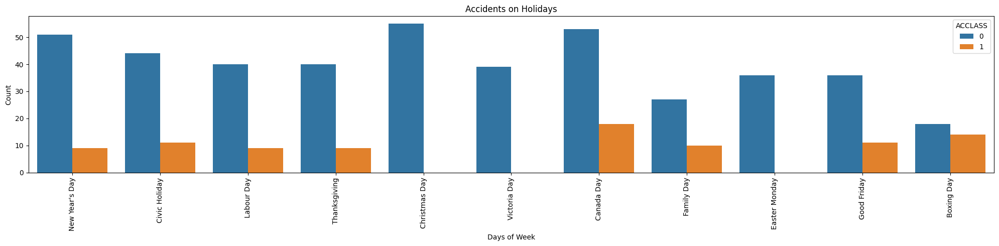

In [ ]:
#DRAWING ACCIDENTS' GRAPH IN HOLIDAYS
fig = plt.figure(figsize= (20,5))
sns.countplot(x=preprocessed_df[preprocessed_df['HOLIDAY_NAME']!='NoHoliday']['HOLIDAY_NAME'], hue=preprocessed_df['ACCLASS'])
plt.title("Accidents on Holidays")
plt.xlabel("Days of Week")
plt.ylabel("Count")
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

In [ ]:
'''
# convert all columns in the DataFrame to numeric data types
preprocessed_df['LATITUDE'] = preprocessed_df['LATITUDE'].astype(float)
preprocessed_df['LONGITUDE'] = preprocessed_df['LONGITUDE'].astype(float)
preprocessed_df['ACCLASS'] = preprocessed_df['ACCLASS'].astype(int)
preprocessed_df['INVAGE'] = preprocessed_df['INVAGE'].astype(float)
preprocessed_df['PEDESTRIAN'] = preprocessed_df['PEDESTRIAN'].astype(int)
preprocessed_df['CYCLIST'] = preprocessed_df['CYCLIST'].astype(int)
preprocessed_df['AUTOMOBILE'] = preprocessed_df['AUTOMOBILE'].astype(int)
preprocessed_df['MOTORCYCLE'] = preprocessed_df['MOTORCYCLE'].astype(int)
preprocessed_df['TRUCK'] = preprocessed_df['TRUCK'].astype(int)
preprocessed_df['TRSN_CITY_VEH'] = preprocessed_df['TRSN_CITY_VEH'].astype(int)
preprocessed_df['EMERG_VEH'] = preprocessed_df['EMERG_VEH'].astype(int)
preprocessed_df['PASSENGER'] = preprocessed_df['PASSENGER'].astype(int)
preprocessed_df['SPEEDING'] = preprocessed_df['SPEEDING'].astype(int)
preprocessed_df['AG_DRIV'] = preprocessed_df['AG_DRIV'].astype(int)
preprocessed_df['REDLIGHT'] = preprocessed_df['REDLIGHT'].astype(int)
preprocessed_df['ALCOHOL'] = preprocessed_df['ALCOHOL'].astype(int)
preprocessed_df['DISABILITY'] = preprocessed_df['DISABILITY'].astype(int)
preprocessed_df['DRIVER_PROBLEM'] = preprocessed_df['DRIVER_PROBLEM'].astype(int)
preprocessed_df['PEDESTRAIN_PROBLEM'] = preprocessed_df['PEDESTRAIN_PROBLEM'].astype(int)
preprocessed_df['CYCLIST_PROBLEM'] = preprocessed_df['CYCLIST_PROBLEM'].astype(int)
preprocessed_df['MONTH'] = preprocessed_df['MONTH'].astype(int)
preprocessed_df['WEEKDAY'] = preprocessed_df['WEEKDAY'].astype(int)
preprocessed_df['HOUR'] = preprocessed_df['HOUR'].astype(int)
'''
#Convert the columns that can give information as numeric features
preprocessed_df['INVAGE'] = preprocessed_df['INVAGE'].astype(float)
preprocessed_df['FATALITY_RATE'] = preprocessed_df['FATALITY_RATE'].astype(float)
preprocessed_df['HOUR'] = preprocessed_df['HOUR'].astype(int)

In [ ]:
# Check for missing values:
miss_val = preprocessed_df.isnull().sum()
miss_val=miss_val.drop(miss_val[miss_val == 0].index).sort_values(ascending = False)
pd.DataFrame({'Missing Values':miss_val, 'Percent':round(miss_val/len(preprocessed_df),2)*100})

,Missing Values,Percent


In [ ]:
preprocessed_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18189 entries, 0 to 18188
Data columns (total 36 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   VISIBILITY          18189 non-null  object 
 1   INVTYPE             18189 non-null  object 
 2   RDSFCOND            18189 non-null  object 
 3   DISTRICT            18189 non-null  object 
 4   TRAFFCTL            18189 non-null  object 
 5   IMPACTYPE           18189 non-null  object 
 6   ROAD_CLASS          18189 non-null  object 
 7   HOOD_158            18189 non-null  object 
 8   LATITUDE            18189 non-null  object 
 9   LONGITUDE           18189 non-null  object 
 10  ACCLOC              18189 non-null  object 
 11  LIGHT               18189 non-null  object 
 12  ACCLASS             18189 non-null  object 
 13  INVAGE              18189 non-null  float64
 14  PEDESTRIAN          18189 non-null  object 
 15  CYCLIST             18189 non-null  object 
 16  AUTO

### CHI-SQUARE TESTING

**Null hypothesis:** States that there is no relation between the variables.

**Alternate hypothesis:** State that there is a significant relationship between the two variables.

In [ ]:
target_col = 'ACCLASS'
independent_cols = list(preprocessed_df.columns)

related_features=[]
unrelated_features=[]
for i in independent_cols:
  temp=pd.crosstab(index=preprocessed_df[i], columns=preprocessed_df[target_col])
  stat, p, dof, expected = chi2_contingency(temp)
  alpha = 0.05
  #print(i +":p value is " + str(p))
  if p <= alpha:
    related_features.append(i)
    #print('Dependent (reject H0)')
  else:
    unrelated_features.append(i)
    #print('Independent (H0 holds true)')

labels = ['Related'] * len(related_features) + ['Unrelated'] * len(unrelated_features)
contingency_data = {'Feature': related_features + unrelated_features, 'Label': labels}
contingency_df = pd.DataFrame(contingency_data)
display(contingency_df)

,Feature,Label
0,VISIBILITY,Related
1,INVTYPE,Related
2,RDSFCOND,Related
3,DISTRICT,Related
4,TRAFFCTL,Related
5,IMPACTYPE,Related
6,ROAD_CLASS,Related
7,HOOD_158,Related
8,LATITUDE,Related
9,LONGITUDE,Related


In [ ]:
#Dropping the unrelated features
preprocessed_df.drop(unrelated_features,axis=1, inplace=True)

### Testing Multicollinearity

In [ ]:
#Testing the multicollinearity
from statsmodels.stats.outliers_influence import variance_inflation_factor
categorical_features = preprocessed_df.select_dtypes(include='object')

encoded_categorical_features = categorical_features.copy()
encoded_features = ['VISIBILITY', 'HOOD_158','INVTYPE', 'RDSFCOND', 'DISTRICT', 'TRAFFCTL','IMPACTYPE', 'ROAD_CLASS','ACCLOC','LIGHT','HOLIDAY_NAME']

label_encoder = LabelEncoder()

for column in encoded_features:
    encoded_categorical_features[column] = label_encoder.fit_transform(encoded_categorical_features[column])

In [ ]:

encoded_categorical_features['LATITUDE'] = encoded_categorical_features['LATITUDE'].astype(float)
encoded_categorical_features['LONGITUDE'] = encoded_categorical_features['LONGITUDE'].astype(float)
encoded_categorical_features['ACCLASS'] = encoded_categorical_features['ACCLASS'].astype(int)
encoded_categorical_features['PEDESTRIAN'] = encoded_categorical_features['PEDESTRIAN'].astype(int)
encoded_categorical_features['CYCLIST'] = encoded_categorical_features['CYCLIST'].astype(int)
encoded_categorical_features['AUTOMOBILE'] = encoded_categorical_features['AUTOMOBILE'].astype(int)
encoded_categorical_features['TRUCK'] = encoded_categorical_features['TRUCK'].astype(int)
encoded_categorical_features['TRSN_CITY_VEH'] = encoded_categorical_features['TRSN_CITY_VEH'].astype(int)
encoded_categorical_features['SPEEDING'] = encoded_categorical_features['SPEEDING'].astype(int)
encoded_categorical_features['AG_DRIV'] = encoded_categorical_features['AG_DRIV'].astype(int)
encoded_categorical_features['ALCOHOL'] = encoded_categorical_features['ALCOHOL'].astype(int)
encoded_categorical_features['DRIVER_PROBLEM'] = encoded_categorical_features['DRIVER_PROBLEM'].astype(int)
encoded_categorical_features['CYCLIST_PROBLEM'] = encoded_categorical_features['CYCLIST_PROBLEM'].astype(int)
encoded_categorical_features['MONTH'] = encoded_categorical_features['MONTH'].astype(int)
encoded_categorical_features['WEEKDAY'] = encoded_categorical_features['WEEKDAY'].astype(int)
encoded_categorical_features['ISHOLIDAY'] = encoded_categorical_features['ISHOLIDAY'].astype(int)

encoded_categorical_features.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 18189 entries, 0 to 18188
Data columns (total 27 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   VISIBILITY       18189 non-null  int64  
 1   INVTYPE          18189 non-null  int64  
 2   RDSFCOND         18189 non-null  int64  
 3   DISTRICT         18189 non-null  int64  
 4   TRAFFCTL         18189 non-null  int64  
 5   IMPACTYPE        18189 non-null  int64  
 6   ROAD_CLASS       18189 non-null  int64  
 7   HOOD_158         18189 non-null  int64  
 8   LATITUDE         18189 non-null  float64
 9   LONGITUDE        18189 non-null  float64
 10  ACCLOC           18189 non-null  int64  
 11  LIGHT            18189 non-null  int64  
 12  ACCLASS          18189 non-null  int64  
 13  PEDESTRIAN       18189 non-null  int64  
 14  CYCLIST          18189 non-null  int64  
 15  AUTOMOBILE       18189 non-null  int64  
 16  TRUCK            18189 non-null  int64  
 17  TRSN_CITY_VE

In [ ]:

vif = pd.DataFrame(index=encoded_categorical_features.columns)
#vif[categorical_features.columns
vif["VIF"] = [variance_inflation_factor(encoded_categorical_features.values, i) for i in range(encoded_categorical_features.shape[1])]

print(vif)


                           VIF
VISIBILITY            2.650927
INVTYPE               3.874228
RDSFCOND              2.837425
DISTRICT              3.399294
TRAFFCTL              3.316442
IMPACTYPE             5.093833
ROAD_CLASS           12.735738
HOOD_158              4.909737
LATITUDE         235168.887692
LONGITUDE        235518.141389
ACCLOC                3.222343
LIGHT                 3.524549
ACCLASS               1.230311
PEDESTRIAN            2.321102
CYCLIST               1.789668
AUTOMOBILE           17.903885
TRUCK                 1.398198
TRSN_CITY_VEH         1.417859
SPEEDING              1.572280
AG_DRIV               2.956038
ALCOHOL               1.116976
ISHOLIDAY             2.431561
HOLIDAY_NAME        241.143093
DRIVER_PROBLEM        1.842906
CYCLIST_PROBLEM       1.198703
MONTH                 5.437877
WEEKDAY               3.507809


If VIF score is above 10, it indicates multicollinearity between features

VIF scores for Latitude and Longitude are unusual. We think, we can exclude them. The VIF for HOOD_158 feature is reasonable. We can include HOOD_158 feature to the model and in terms of that we can include the location information to our model.

Additionally VIF scores for ROAD_CLASS and AUTOMOBILE are also higher than 10. We can try to build the model without them

In [ ]:
preprocessed_df.drop(['LATITUDE', 'LONGITUDE','ROAD_CLASS','AUTOMOBILE','HOLIDAY_NAME'], axis=1, inplace=True)

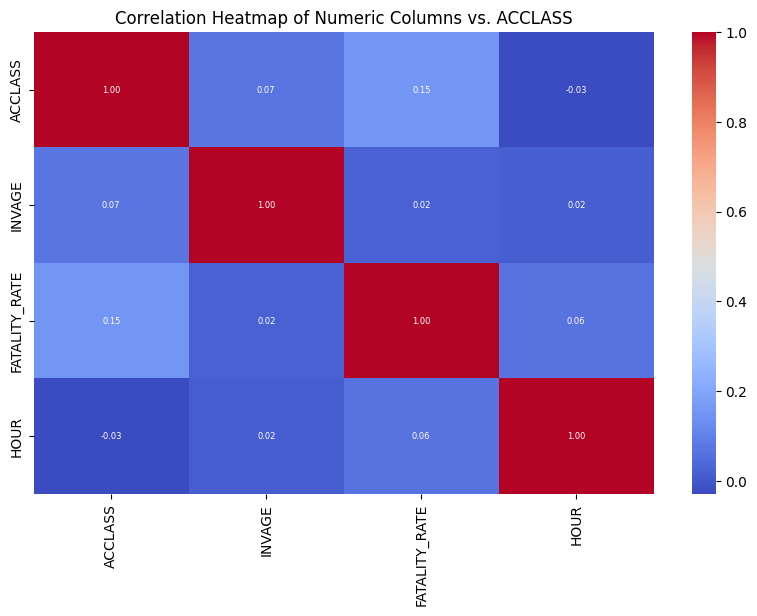

In [ ]:
#This dataframe only used for correlation matrix for numerical features
preprocessed_df_corr = preprocessed_df.copy()

preprocessed_df_corr['ACCLASS'] = preprocessed_df_corr['ACCLASS'].astype(int)

# Plot the correlation matrix using heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(preprocessed_df_corr.corr(), annot=True, cmap='coolwarm', fmt='.2f', annot_kws={'size': 6})
plt.title("Correlation Heatmap of Numeric Columns vs. ACCLASS")
plt.xticks(rotation=90)
plt.show()

Although the correlations for "INVAGE" and "FATALITY_RATE" are very low, we will include them into our model, because we believe they have valuable information for our prediction

In [ ]:
# Dump CSV #colab
output_path = "/content/KSI_NEW.csv"
preprocessed_df.to_csv(output_path, index=False)

In [ ]:
# Convert categorical variables to numerical using label encoding
labelEncoder = LabelEncoder()
categorical_features = preprocessed_df.select_dtypes(include='object')
categorical_features = categorical_features.apply(labelEncoder.fit_transform)
#categorical_features.head()
preprocessed_df['ACCLASS'] = preprocessed_df['ACCLASS'].astype(int)

In [ ]:
# SelectKBest with Chi-Square Test scoring function (best all)
bestfeatures = SelectKBest(score_func=chi2)
fit = bestfeatures.fit(categorical_features, preprocessed_df["ACCLASS"])
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(categorical_features.columns)
featureScores = pd.concat([dfcolumns, dfscores], axis=1)
featureScores.columns = ['Features', 'Score']
print(featureScores.nlargest(16,'Score'))

           Features         Score
9           ACCLASS  15616.000000
6          HOOD_158    406.047118
1           INVTYPE    278.715362
12            TRUCK    217.820808
7            ACCLOC    200.831761
14         SPEEDING    134.044166
4          TRAFFCTL    132.381852
10       PEDESTRIAN    102.468865
11          CYCLIST     90.354216
3          DISTRICT     54.742299
13    TRSN_CITY_VEH     46.272551
8             LIGHT     44.848816
5         IMPACTYPE     16.338551
19  CYCLIST_PROBLEM     13.303088
16          ALCOHOL     12.458917
15          AG_DRIV      7.888983


In [ ]:
y = preprocessed_df["ACCLASS"]
X = preprocessed_df.drop("ACCLASS", axis = 1)

In [ ]:
# Test Train Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify = y)

### SMOTE OVERSAMPLING

In [ ]:
numerical_features_os = X_train.select_dtypes(include=['float64', 'int64'])
categorical_features_os = X_train.select_dtypes(include=['object'])

smote_numeric = SMOTE(sampling_strategy='auto', random_state=42)

smote_cat = SMOTEN(sampling_strategy='auto', random_state=42)

X_train_numeric_resampled, y_train_numeric_resampled = smote_numeric.fit_resample(numerical_features_os, y_train)

X_train_cat_resampled, y_train_cat_resampled = smote_cat.fit_resample(categorical_features_os, y_train)

In [ ]:
print(X_train_cat_resampled.shape)
print(X_train_numeric_resampled.shape)
print(y_train_cat_resampled.shape)
print(y_train_numeric_resampled.shape)

(24986, 21)
(24986, 3)
(24986,)
(24986,)


In [ ]:
#concatinate the categorical and numerical SMOTED dataframes
X_train_resampled = pd.concat([X_train_numeric_resampled, X_train_cat_resampled], axis=1)

In [ ]:
#Checking if resampled y_train sets are the same
y_train_cat_resampled.equals(y_train_numeric_resampled)

True

In [ ]:
y_train_resampled = y_train_numeric_resampled

In [ ]:
X_train_resampled.shape

(24986, 24)

In [ ]:
# Feature Selections
X_train_resampled = X_train_resampled[['TRUCK', 'PEDESTRIAN', 'SPEEDING', 'TRSN_CITY_VEH', 'CYCLIST', 'HOOD_158', 'INVTYPE', 'ACCLOC', 'TRAFFCTL','DISTRICT','INVAGE','FATALITY_RATE']]
X_test = X_test[['TRUCK', 'PEDESTRIAN', 'SPEEDING', 'TRSN_CITY_VEH', 'CYCLIST', 'HOOD_158', 'INVTYPE', 'ACCLOC', 'TRAFFCTL','DISTRICT','INVAGE','FATALITY_RATE']]

In [ ]:
X_train_resampled.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24986 entries, 0 to 24985
Data columns (total 12 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   TRUCK          24986 non-null  object 
 1   PEDESTRIAN     24986 non-null  object 
 2   SPEEDING       24986 non-null  object 
 3   TRSN_CITY_VEH  24986 non-null  object 
 4   CYCLIST        24986 non-null  object 
 5   HOOD_158       24986 non-null  object 
 6   INVTYPE        24986 non-null  object 
 7   ACCLOC         24986 non-null  object 
 8   TRAFFCTL       24986 non-null  object 
 9   DISTRICT       24986 non-null  object 
 10  INVAGE         24986 non-null  float64
 11  FATALITY_RATE  24986 non-null  float64
dtypes: float64(2), object(10)
memory usage: 2.3+ MB


In [ ]:
label_encoder = LabelEncoder()
categorical_features_encoding = X_train_resampled.select_dtypes(include=['object'])

for column in categorical_features_encoding:
    X_train_resampled[column] = label_encoder.fit_transform(X_train_resampled[column])
    X_test[column] = label_encoder.fit_transform(X_test[column])

### Logistic Regression

In [ ]:
# Logistic Regression and GridSearchCV
param_grid_logistic = {
    'C': [0.1, 1.0, 10.0],
    'solver': ['lbfgs', 'liblinear', 'sag', 'saga'],
    'penalty': ['l1', 'l2', 'None']
}

logistic_regression_model = LogisticRegression()

grid_search_logistic = GridSearchCV(logistic_regression_model, param_grid=param_grid_logistic, cv=5)
grid_search_logistic.fit(X_train_resampled, y_train_resampled)

best_params_logistic = grid_search_logistic.best_params_
print("Best Hyperparameters for Logistic Regression:")
print(best_params_logistic)

# Evaluate on the test set
y_pred_logistic = grid_search_logistic.predict(X_test)
accuracy_logistic = accuracy_score(y_test, y_pred_logistic)
precision_logistic = precision_score(y_test, y_pred_logistic, average="macro")*100
recall_logistic = recall_score(y_test, y_pred_logistic, average="macro")*100
print(f"Logistic Regression Accuracy: {accuracy_logistic:.4f}")
print(f"Logistic Regression Precision: {precision_logistic:.4f}")
print(f"Logistic Regression Recall: {recall_logistic:.4f}")
print('Confusion Matrix: ')
confusion_matrix(y_test, y_pred_logistic)

Best Hyperparameters for Logistic Regression:
{'C': 1.0, 'penalty': 'l2', 'solver': 'liblinear'}
Logistic Regression Accuracy: 0.6069
Logistic Regression Precision: 56.7578
Logistic Regression Recall: 63.7276
Confusion Matrix: 


array([[1858, 1265],
       [ 165,  350]])

In [ ]:
# Dump Logistic Regression model with best parameters
best_logistic_model = grid_search_logistic.best_estimator_
best_logistic_params = grid_search_logistic.best_params_
joblib.dump(best_logistic_model, 'best_logistic_model.h5')
joblib.dump(best_logistic_params, 'best_logistic_params.h5')

NameError: ignored

### Decision Tree

In [ ]:
# Decision Tree model
decision_tree_model = DecisionTreeClassifier()

param_grid = {
    'criterion': ['gini', 'entropy'], # The function to measure the quality of a split
    'splitter': ['best', 'random'],   # The strategy used to choose the split at each node
    'max_depth': np.arange(1, 35),    # The maximum depth of the tree
    'min_samples_split': np.arange(2, 25),    # The minimum number of samples required to split an internal node
    'min_samples_leaf': np.arange(1, 30),     # The minimum number of samples required to be at a leaf node
    'max_features': ['auto', 'sqrt', 'log2', None]    # The number of features to consider when looking for the best split
}

randomized_search_decision_tree = RandomizedSearchCV(decision_tree_model, param_distributions=param_grid, n_iter=100, cv=5)
randomized_search_decision_tree.fit(X_train_resampled, y_train_resampled)

best_params_randomized_decision_tree = randomized_search_decision_tree.best_params_
print("Best Parameters for Decision Tree (Randomized Search):")
print(best_params_randomized_decision_tree)

# Evaluate on the test set
y_pred_randomized_decision_tree = randomized_search_decision_tree.predict(X_test)
accuracy_randomized_decision_tree = accuracy_score(y_test, y_pred_randomized_decision_tree)
precision_randomized_decision_tree = precision_score(y_test, y_pred_randomized_decision_tree, average="macro")*100
recall_randomized_decision_tree = recall_score(y_test, y_pred_randomized_decision_tree, average="macro")*100
print(f"Randomized Decision Tree Accuracy: {accuracy_randomized_decision_tree:.4f}")
print(f"Randomized Decision Tree Precision: {precision_randomized_decision_tree:.4f}")
print(f"Randomized Decision Tree Recall: {recall_randomized_decision_tree:.4f}")

Best Parameters for Decision Tree (Randomized Search):
{'splitter': 'best', 'min_samples_split': 11, 'min_samples_leaf': 5, 'max_features': None, 'max_depth': 21, 'criterion': 'gini'}
Randomized Decision Tree Accuracy: 0.7639
Randomized Decision Tree Precision: 59.4774
Randomized Decision Tree Recall: 63.5456


In [ ]:
# Dump Decision Tree model with best parameters
best_decision_tree_model = randomized_search_decision_tree.best_estimator_
best_decision_tree_params = randomized_search_decision_tree.best_params_
joblib.dump(best_decision_tree_model, 'best_decision_tree_model.h5')
joblib.dump(best_decision_tree_params, 'best_decision_tree_params.h5')

### Random Forest

In [ ]:
# Create the Random Forest model
random_forest_model = RandomForestClassifier()

param_grid = {
    'n_estimators': np.arange(100, 1001, 250),    # Number of trees in the forest
    'criterion': ['gini', 'entropy'],             # The function to measure the quality of a split
    'max_depth': np.arange(1, 35),                # The maximum depth of the trees
    'min_samples_split': np.arange(2, 30),        # The minimum number of samples required to split an internal node
    'min_samples_leaf': np.arange(1, 21),         # The minimum number of samples required to be at a leaf node
    'max_features': ['auto', 'sqrt', 'log2'],     # The number of features to consider when looking for the best split
    'bootstrap': [True, False]                    # Whether bootstrap samples are used when building trees
}

# Randomized Search
randomized_search_random_forest = RandomizedSearchCV(random_forest_model, param_distributions=param_grid, n_iter=100, cv=5)
randomized_search_random_forest.fit(X_train_resampled, y_train_resampled)

best_params_randomized_random_forest = randomized_search_random_forest.best_params_
print("Best Parameters for Random Forest (Randomized Search):")
print(best_params_randomized_random_forest)

# Evaluate on the test set
y_pred_randomized_random_forest = randomized_search_random_forest.predict(X_test)
accuracy_randomized_random_forest = accuracy_score(y_test, y_pred_randomized_random_forest)
precision_randomized_random_forest = precision_score(y_test, y_pred_randomized_random_forest, average="macro")*100
recall_randomized_random_forest = recall_score(y_test, y_pred_randomized_random_forest, average="macro")*100
print(f"Random Forest Accuracy (Randomized Search): {accuracy_randomized_random_forest:.4f}")
print(f"Random Forest Precision (Randomized Search): {precision_randomized_random_forest:.4f}")
print(f"Random Forest Recall (Randomized Search): {recall_randomized_random_forest:.4f}")

Best Parameters for Random Forest (Randomized Search):
{'n_estimators': 600, 'min_samples_split': 8, 'min_samples_leaf': 3, 'max_features': 'auto', 'max_depth': 29, 'criterion': 'entropy', 'bootstrap': False}
Random Forest Accuracy (Randomized Search): 0.8422
Random Forest Precision (Randomized Search): 66.4765
Random Forest Recall (Randomized Search): 64.2168


In [ ]:
# Dump Random Forest model with best parameters
best_random_forest_model = randomized_search_random_forest.best_estimator_
best_random_forest_params = randomized_search_random_forest.best_params_
joblib.dump(best_random_forest_model, 'best_random_forest_model.h5')
joblib.dump(best_random_forest_params, 'best_random_forest_params.h5')

NameError: ignored

### MLP Neural Network

In [ ]:
# Create the Neural Network model
neural_network_model = MLPClassifier()
param_grid_neural_network = {
    'hidden_layer_sizes': [(2), (3), (3,5)],
    'activation': ['relu', 'tanh'],
    'solver': ['adam', 'sgd'],
    'alpha': [0.0001, 0.001, 0.01],
    'learning_rate': ['constant', 'invscaling', 'adaptive']
}

grid_search_neural_network = GridSearchCV(neural_network_model, param_grid=param_grid_neural_network, cv=5)
grid_search_neural_network.fit(X_train_resampled, y_train_resampled)

best_params_grid_neural_network = grid_search_neural_network.best_params_
print("Best Parameters for Neural Network (Grid Search):")
print(best_params_grid_neural_network)

# Evaluate on the test set
y_pred_neural_network = grid_search_neural_network.predict(X_test)
accuracy_neural_network = accuracy_score(y_test, y_pred_neural_network)
precision_neural_network = precision_score(y_test, y_pred_neural_network, average="macro")*100
recall_neural_network = recall_score(y_test, y_pred_neural_network, average="macro")*100
print(f"Neural Network Accuracy (Grid Search): {accuracy_neural_network:.4f}")
print(f"Neural Network Precision (Grid Search): {precision_neural_network:.4f}")
print(f"Neural Network Recall (Grid Search): {recall_neural_network:.4f}")


Best Parameters for Neural Network (Grid Search):
{'activation': 'tanh', 'alpha': 0.01, 'hidden_layer_sizes': (3, 5), 'learning_rate': 'invscaling', 'solver': 'adam'}
Neural Network Accuracy (Grid Search): 0.5690
Neural Network Precision (Grid Search): 55.9577
Neural Network Recall (Grid Search): 62.2479


In [ ]:
# Dump Neural Network model with best parameters
best_neural_network_model = grid_search_neural_network.best_estimator_
best_neural_network_params = grid_search_neural_network.best_params_
joblib.dump(best_neural_network_model, 'best_neural_network_model.h5')
joblib.dump(best_neural_network_params, 'best_neural_network_params.h5')

### XGBoost

In [ ]:
import scipy.stats as stats
xgb_pipeline = Pipeline([
                ("xgb_clf",XGBClassifier(random_state=42))
    ])

parameters={
    'xgb_clf__learning_rate': stats.uniform(0.01, 0.3),
    'xgb_clf__n_estimators': [50, 100, 150, 200],
    'xgb_clf__max_depth': [3, 5, 7, 9],
    'xgb_clf__min_child_weight': [1, 5, 10],
    'xgb_clf__gamma': [0, 0.1, 0.2, 0.3],
    'xgb_clf__subsample': [0.8, 0.9, 1.0],
    'xgb_clf__colsample_bytree': [0.8, 0.9, 1.0],
    'xgb_clf__colsample_bylevel': [0.8, 0.9, 1.0],
    'xgb_clf__reg_alpha': [0, 0.001, 0.01, 0.1, 1.0],
    'xgb_clf__reg_lambda': [0, 0.001, 0.01, 0.1, 1.0],
    'xgb_clf__scale_pos_weight': [1, 2, 5, 10],
    'xgb_clf__eval_metric': ['logloss']
}
xgb_grid_pipeline=RandomizedSearchCV(xgb_pipeline, parameters,n_jobs=-1, cv=5, n_iter=100, refit='str',random_state=42)

xgb_grid_pipeline.fit(X_train_resampled, y_train_resampled)

best_params_randomized_xgboost = xgb_grid_pipeline.best_params_
print("Best Parameters for XGBoost (Randomized Search):")
print(best_params_randomized_xgboost)

# Evaluate on the test set
y_pred_xgboost = xgb_grid_pipeline.predict(X_test)
accuracy_xgboost = accuracy_score(y_test, y_pred_xgboost)
precision_xgboost = precision_score(y_test, y_pred_xgboost, average="macro")*100
recall_xgboost = recall_score(y_test, y_pred_xgboost, average="macro")*100
print(f"XGBoost Accuracy (Randomized Search): {accuracy_xgboost:.4f}")
print(f"XGBoost Precision (Randomized Search): {precision_xgboost:.4f}")
print(f"XGBoost Recall (Randomized Search): {recall_xgboost:.4f}")

Best Parameters for XGBoost (Randomized Search):
{'xgb_clf__colsample_bylevel': 0.9, 'xgb_clf__colsample_bytree': 1.0, 'xgb_clf__eval_metric': 'logloss', 'xgb_clf__gamma': 0.3, 'xgb_clf__learning_rate': 0.25223204654921877, 'xgb_clf__max_depth': 9, 'xgb_clf__min_child_weight': 1, 'xgb_clf__n_estimators': 150, 'xgb_clf__reg_alpha': 0, 'xgb_clf__reg_lambda': 0, 'xgb_clf__scale_pos_weight': 1, 'xgb_clf__subsample': 1.0}
XGBoost Accuracy (Randomized Search): 0.8821
XGBoost Precision (Randomized Search): 76.3649
XGBoost Recall (Randomized Search): 70.1057


In [ ]:
# Dump XGBoost model with best parameters
best_xgboost_model = xgb_grid_pipeline.best_estimator_
best_xgboost_params = xgb_grid_pipeline.best_params_
joblib.dump(best_xgboost_model, 'best_xgboost_model.h5')
joblib.dump(best_xgboost_params, 'best_xgboost_params.h5')

['best_xgboost_params.h5']

### SVM

In [ ]:
# Create the SVM model
svm_model = SVC()

param_grid_svm = {
    'C': [0.1, 1.0],
    'kernel': ['linear', 'poly', 'rbf', 'sigmoid'],
    'gamma': [0.1, 0.01],
}

randomized_search_svm = RandomizedSearchCV(svm_model, param_distributions=param_grid_svm, n_iter=50, cv=5)
randomized_search_svm.fit(X_train_resampled, y_train_resampled)

best_params_randomized_svm = randomized_search_svm.best_params_
print("Best Parameters for SVM (Randomized Search):")
print(best_params_randomized_svm)

# Evaluate on the test set
y_pred_svm = randomized_search_svm.predict(X_test)
accuracy_svm = accuracy_score(y_test, y_pred_svm)
precision_svm = precision_score(y_test, y_pred_svm, average="macro")*100
recall_svm = recall_score(y_test, y_pred_svm, average="macro")*100
print(f"SVC Accuracy (Randomized Search): {accuracy_svm:.4f}")
print(f"SVC Precision (Randomized Search): {precision_svm:.4f}")
print(f"SVC Recall (Randomized Search): {recall_svm:.4f}")


In [ ]:
# Dump XGBoost model with best parameters
best_svm_model = randomized_search_svm.best_estimator_
best_svm_params = randomized_search_svm.best_params_
joblib.dump(best_svm_model, 'best_svm_model.h5')
joblib.dump(best_svm_params, 'best_svm_params.h5')